In [ ]:
import kagglehub

# Download latest version
path = kagglehub.dataset_download("balraj98/monet2photo")

print("Path to dataset files:", path)

100%|██████████| 291M/291M [00:01<00:00, 185MB/s]

Extracting files...


Path to dataset files: /root/.cache/kagglehub/datasets/balraj98/monet2photo/versions/5


In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


**The following implementation follows the original CycleGAN paper: https://arxiv.org/pdf/1703.10593**

In [ ]:
import torch.nn as nn
import torch

class Block(nn.Module):
  def __init__(self, in_channels, out_channels, stride, kernel_size, activation_fn, padding=1, is_downsampling=True, use_instance_norm=True, **kwargs):
    super().__init__()
    bias = not use_instance_norm
    conv_layer = nn.Conv2d(in_channels, out_channels, kernel_size, stride, padding, bias=bias, padding_mode='reflect', **kwargs) if is_downsampling \
    else nn.ConvTranspose2d(in_channels, out_channels, kernel_size, stride, padding, bias=bias, **kwargs)
    self.conv = nn.Sequential(
        conv_layer,
        nn.InstanceNorm2d(out_channels) if use_instance_norm else nn.Identity(),
        activation_fn
    )
  def forward(self, x):
    return self.conv(x)

In [ ]:
class ResidualBlock(nn.Module):
  def __init__(self, channels):
    super().__init__()
    self.block = nn.Sequential(
        Block(channels, channels, 1, 3, nn.ReLU()),
        Block(channels, channels, 1, 3, nn.Identity())
    )

  def forward(self, x):
    return x + self.block(x)

In [ ]:
class Generator(nn.Module):
  def __init__(self):
    super().__init__()
    c7s1_64 = Block(3, 64, 1, 7, nn.ReLU(), padding=3)
    d128 = Block(64, 128, 2, 3, nn.ReLU())
    d256 = Block(128, 256, 2, 3, nn.ReLU())
    r256_blocks = [ResidualBlock(256) for _ in range(9)]
    u128 = Block(256, 128, 2, 3, nn.ReLU(), is_downsampling=False, output_padding=1)
    u64 = Block(128, 64, 2, 3, nn.ReLU(), is_downsampling=False, output_padding=1)
    c7s1_3 = Block(64, 3, 1, 7, nn.Identity(), padding=3, use_instance_norm=False)
    self.generator = nn.Sequential(
        c7s1_64,
        d128,
        d256,
        *r256_blocks,
        u128,
        u64,
        c7s1_3
    )
  def forward(self, x):
    return torch.tanh(self.generator(x))


In [ ]:
class Discriminator(nn.Module):
  def __init__(self):
    super().__init__()
    C64 = Block(3, 64, 2, 4, nn.LeakyReLU(0.2), use_instance_norm=False)
    C128 = Block(64, 128, 2, 4, nn.LeakyReLU(0.2))
    C256 = Block(128, 256, 2, 4, nn.LeakyReLU(0.2))
    C512 = Block(256, 512, 1, 4, nn.LeakyReLU(0.2))
    last_conv = nn.Conv2d(512, 1, 4, 1, 1)
    self.discriminator = nn.Sequential(
        C64,
        C128,
        C256,
        C512,
        last_conv
    )
  def forward(self, x):
    return torch.sigmoid(self.discriminator(x))


In [ ]:
from PIL import Image
import os
from torch.utils.data import Dataset
import numpy as np

class MonetPhotoDataset(Dataset):
    def __init__(self, root_photo, root_monet, transform=None):
        self.root_photo = root_photo
        self.root_monet = root_monet
        self.transform = transform

        self.photo_images = os.listdir(root_photo)
        self.monet_images = os.listdir(root_monet)
        self.length_dataset = max(len(self.photo_images), len(self.monet_images))
        self.photo_len = len(self.photo_images)
        self.monet_len = len(self.monet_images)

    def __len__(self):
        return self.length_dataset

    def __getitem__(self, index):
        photo_img = self.photo_images[index % self.photo_len]
        monet_img = self.monet_images[index % self.monet_len]

        photo_path = os.path.join(self.root_photo, photo_img)
        monet_path = os.path.join(self.root_monet, monet_img)

        photo_img = np.array(Image.open(photo_path).convert("RGB"))
        monet_img = np.array(Image.open(monet_path).convert("RGB"))

        if self.transform:
            augmentations = self.transform(image=photo_img, image0=monet_img)
            photo_img = augmentations["image"]
            monet_img = augmentations["image0"]

        return photo_img, monet_img


In [ ]:
%cd /content/drive/MyDrive/AI/CycleGAN/data/monet2photo/5
!ls

/content/drive/MyDrive/AI/CycleGAN/data/monet2photo/5
metadata.csv  models  models2  outputs	outputs2  testA  testB	trainA	trainB


In [ ]:
import torch
import albumentations as A
from albumentations.pytorch import ToTensorV2

DEVICE = "cuda" if torch.cuda.is_available() else "cpu"
print(f"using device: {DEVICE}")

TRAIN_DIR = "data/train"
VAL_DIR = "data/val"
BATCH_SIZE = 1
LEARNING_RATE = 2e-4
LAMBDA_IDENTITY = 5 # loss weight for identity loss
LAMBDA_CYCLE = 10
NUM_WORKERS = 4
NUM_EPOCHS = 3
LOAD_MODEL = False
SAVE_MODEL = True
CHECKPOINT_GENERATOR_M = "models/genh.pth.tar"
CHECKPOINT_GENERATOR_P = "models/genz.pth.tar"
CHECKPOINT_DISCRIMINATOR_M = "models/disch.pth.tar"
CHECKPOINT_DISCRIMINATOR_P = "models/discz.pth.tar"

transforms = A.Compose(
    [
        A.RandomCrop(width=256, height=256),
        A.Resize(width=256, height=256),
        A.HorizontalFlip(p=0.5),
        A.Normalize(mean=[0.5, 0.5, 0.5], std=[0.5, 0.5, 0.5], max_pixel_value=255),
        ToTensorV2(),
    ],
    additional_targets={"image0": "image"},
)

using device: cuda


In [ ]:
import random, torch, os, numpy as np
import torch.nn as nn
import copy

def save_checkpoint(model, optimizer, filename="models/checkpoint.pth.tar"):
    print("=> Saving checkpoint")
    checkpoint = {
        "state_dict": model.state_dict(),
        "optimizer": optimizer.state_dict(),
    }
    torch.save(checkpoint, filename)


def load_checkpoint(checkpoint_file, model, optimizer, lr):
    print("=> Loading checkpoint")
    checkpoint = torch.load(checkpoint_file, map_location=DEVICE)
    model.load_state_dict(checkpoint["state_dict"])
    optimizer.load_state_dict(checkpoint["optimizer"])

    for param_group in optimizer.param_groups:
        param_group["lr"] = lr


def seed_everything(seed=42):
    os.environ["PYTHONHASHSEED"] = str(seed)
    random.seed(seed)
    np.random.seed(seed)
    torch.manual_seed(seed)
    torch.cuda.manual_seed(seed)
    torch.cuda.manual_seed_all(seed)
    torch.backends.cudnn.deterministic = True
    torch.backends.cudnn.benchmark = False

In [ ]:
import torch
import sys
from torch.utils.data import DataLoader
import torch.nn as nn
import torch.optim as optim
from tqdm import tqdm
from torchvision.utils import save_image
from torchvision.utils import make_grid
import matplotlib.pyplot as plt

def denorm(t): return t*0.5 + 0.5
def set_req(nets, req=False):
    for net in nets:
        for p in net.parameters():
            p.requires_grad = req


def smooth_curve(values, beta=0.9):
    smoothed = []
    avg = 0
    for v in values:
        avg = beta * avg + (1 - beta) * v
        smoothed.append(avg / (1 - beta ** (len(smoothed)+1)))
    return smoothed

def train_fn(
    disc_M, disc_P, gen_P, gen_M, loader, opt_disc, opt_gen, l1, mse, d_scaler, g_scaler, g_losses, d_losses
):
    M_reals = 0
    M_fakes = 0
    loop = tqdm(loader, leave=True)

    for idx, (photo, monet) in enumerate(loop):
        photo = photo.to(DEVICE)
        monet = monet.to(DEVICE)

        # Train discriminators
        with torch.cuda.amp.autocast():
            set_req([disc_M, disc_P], True)
            fake_monet = gen_M(photo)
            D_M_real = disc_M(monet)
            D_M_fake = disc_M(fake_monet.detach())
            M_reals += D_M_real.mean().item()
            M_fakes += D_M_fake.mean().item()
            D_M_real_loss = mse(D_M_real, torch.ones_like(D_M_real))
            D_M_fake_loss = mse(D_M_fake, torch.zeros_like(D_M_fake))
            D_M_loss = D_M_real_loss + D_M_fake_loss

            fake_photo = gen_P(monet)
            D_P_real = disc_P(photo)
            D_P_fake = disc_P(fake_photo.detach())
            D_P_real_loss = mse(D_P_real, torch.ones_like(D_P_real))
            D_P_fake_loss = mse(D_P_fake, torch.zeros_like(D_P_fake))
            D_P_loss = D_P_real_loss + D_P_fake_loss

            D_loss = (D_M_loss + D_P_loss) / 2
            d_losses.append(D_loss.item())

        opt_disc.zero_grad()
        d_scaler.scale(D_loss).backward()
        d_scaler.step(opt_disc)
        d_scaler.update()

        # Train generators
        with torch.cuda.amp.autocast():
            set_req([disc_M, disc_P], False)
            # adversarial losses
            D_M_fake = disc_M(fake_monet)
            D_P_fake = disc_P(fake_photo)
            loss_G_M = mse(D_M_fake, torch.ones_like(D_M_fake))
            loss_G_P = mse(D_P_fake, torch.ones_like(D_P_fake))

            # cycle losses
            cycle_photo = gen_P(fake_monet)
            cycle_monet = gen_M(fake_photo)
            cycle_photo_loss = l1(photo, cycle_photo)
            cycle_monet_loss = l1(monet, cycle_monet)

            # identity losses
            identity_photo = gen_P(photo)
            identity_monet = gen_M(monet)
            identity_photo_loss = l1(photo, identity_photo)
            identity_monet_loss = l1(monet, identity_monet)

            # total loss
            G_loss = (
                loss_G_P
                + loss_G_M
                + cycle_photo_loss * LAMBDA_CYCLE
                + cycle_monet_loss * LAMBDA_CYCLE
                + identity_monet_loss * LAMBDA_IDENTITY
                + identity_photo_loss * LAMBDA_IDENTITY
            )
            g_losses.append(G_loss.item())

        opt_gen.zero_grad()
        g_scaler.scale(G_loss).backward()
        g_scaler.step(opt_gen)
        g_scaler.update()

        if idx % 200 == 0:
            save_image(denorm(fake_monet), f"outputs/monet_{idx}.png")
            save_image(denorm(fake_photo), f"outputs/photo_{idx}.png")
            with torch.no_grad():
              grid = make_grid([
                  denorm(monet[0].cpu()),
                  denorm(fake_photo[0].cpu()),
                  denorm(photo[0].cpu()),
                  denorm(fake_monet[0].cpu())
              ], nrow=2, padding=2)

            plt.figure(figsize=(4,4))
            plt.imshow(grid.permute(1,2,0))
            plt.axis('off')
            plt.show()

            fig, axs = plt.subplots(1, 2, figsize=(12, 6))

            axs[0].plot(g_losses, alpha=0.3, label="raw")
            axs[0].plot(smooth_curve(g_losses, beta=0.9), label="smoothed")
            axs[0].set_title('Generator Loss')
            axs[0].legend()

            axs[1].plot(d_losses, alpha=0.3, label="raw")
            axs[1].plot(smooth_curve(d_losses, beta=0.9), label="smoothed")
            axs[1].set_title('Discriminator Loss')
            axs[1].legend()

            plt.tight_layout()
            plt.show()



        loop.set_postfix(M_real=M_reals / (idx + 1), M_fake=M_fakes / (idx + 1))


In [ ]:
def my_scheduler(total_steps):
  # middle = NUM_EPOCHS // 2
  # if total_steps <= middle:
  return 1.0
  # else:
  #   return 1.0 - min(total_steps - middle, middle) / middle

/tmp/ipython-input-3546115178.py:71: FutureWarning: `torch.cuda.amp.GradScaler(args...)` is deprecated. Please use `torch.amp.GradScaler('cuda', args...)` instead.
  g_scaler = torch.cuda.amp.GradScaler()
/tmp/ipython-input-3546115178.py:72: FutureWarning: `torch.cuda.amp.GradScaler(args...)` is deprecated. Please use `torch.amp.GradScaler('cuda', args...)` instead.
  d_scaler = torch.cuda.amp.GradScaler()
  0%|          | 0/6287 [00:00<?, ?it/s]/tmp/ipython-input-2067346347.py:38: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with torch.cuda.amp.autocast():
/tmp/ipython-input-2067346347.py:65: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with torch.cuda.amp.autocast():


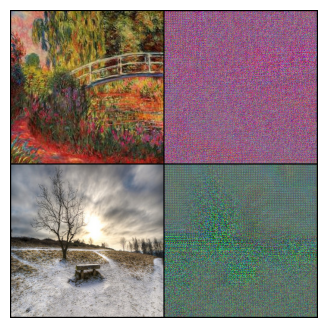

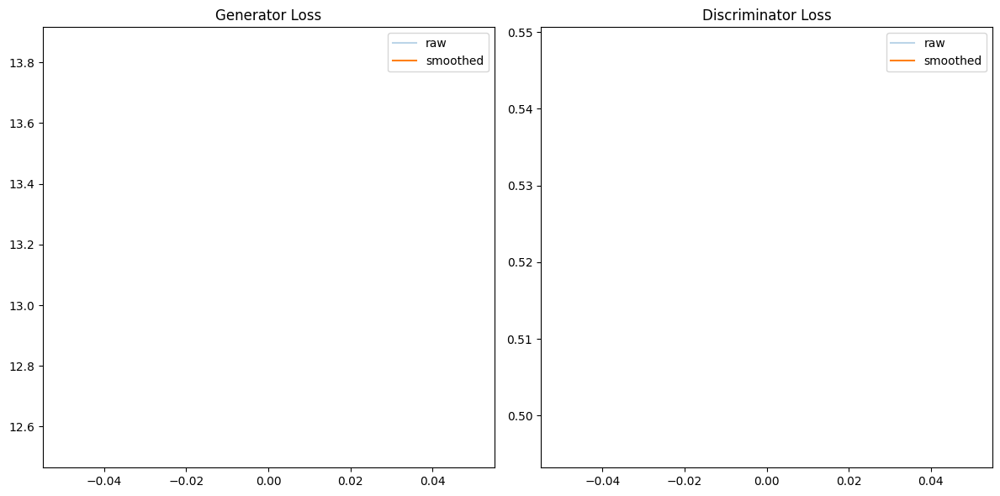

  3%|▎         | 200/6287 [00:22<09:02, 11.23it/s, M_fake=0.473, M_real=0.533]

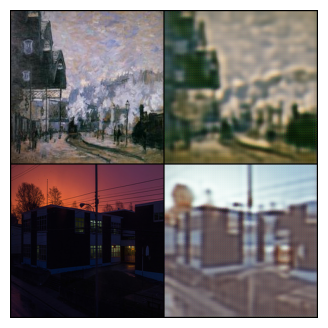

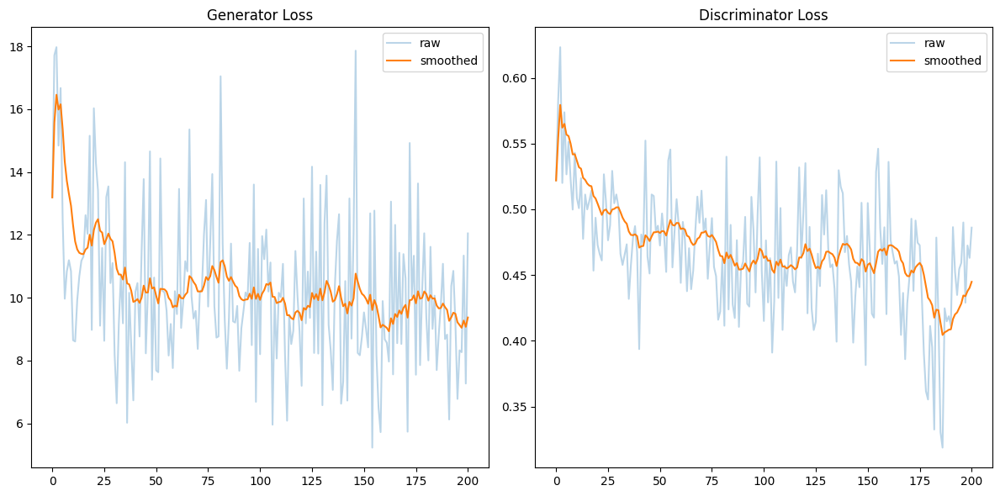

  6%|▋         | 400/6287 [00:41<08:59, 10.91it/s, M_fake=0.46, M_real=0.541]

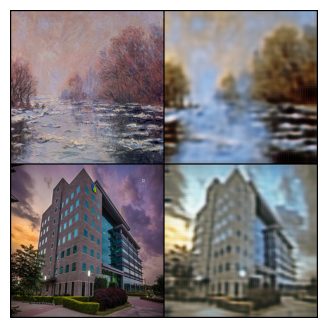

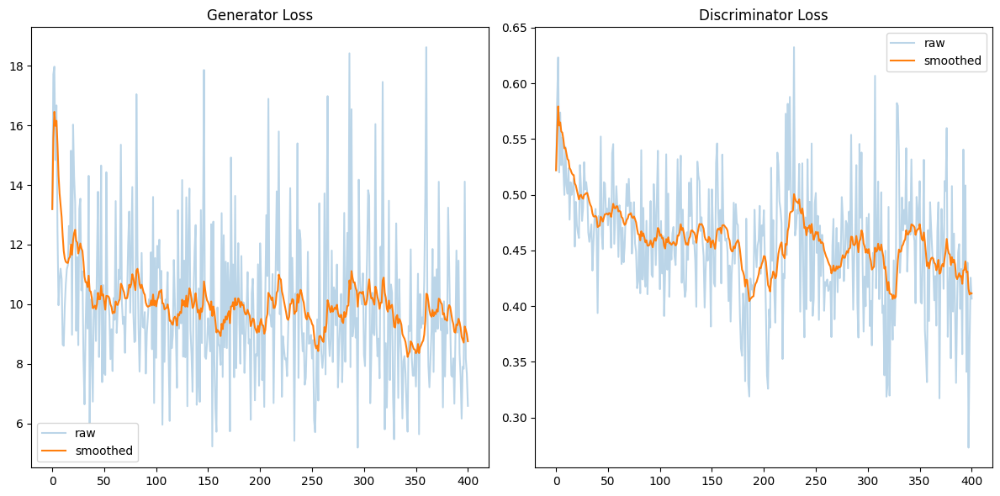

 10%|▉         | 600/6287 [00:59<08:30, 11.14it/s, M_fake=0.44, M_real=0.562]

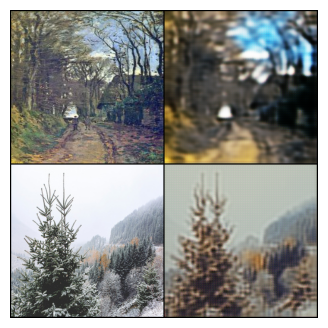

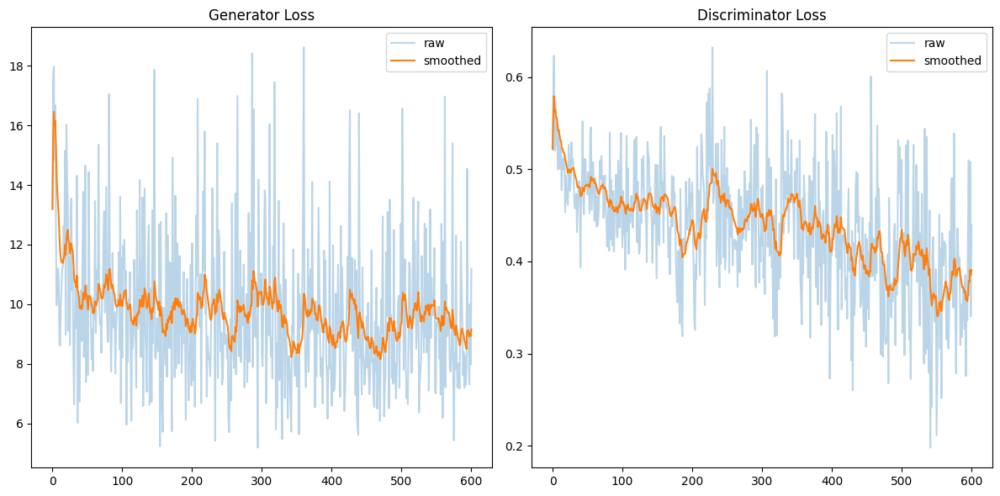

 13%|█▎        | 800/6287 [01:18<08:20, 10.96it/s, M_fake=0.429, M_real=0.573]

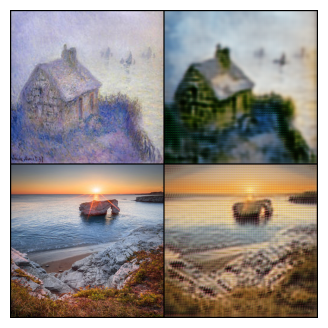

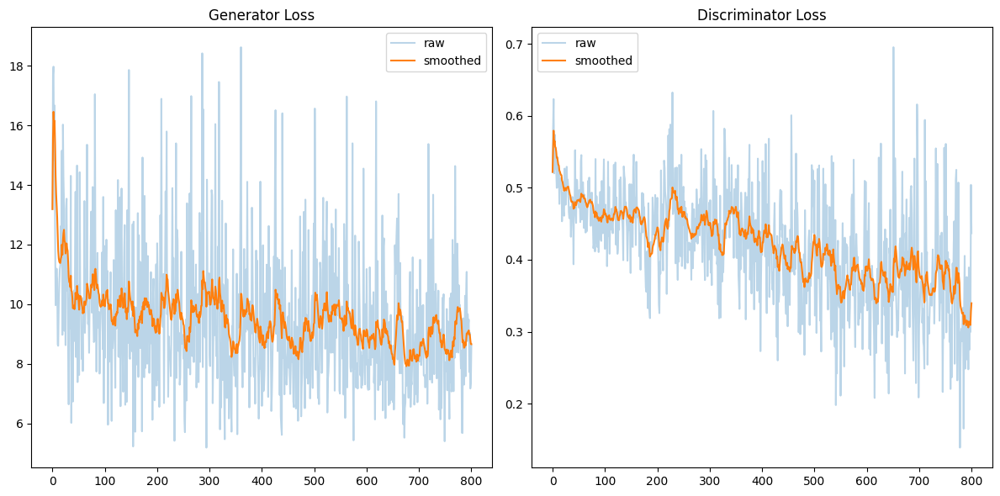

 16%|█▌        | 1000/6287 [01:36<07:56, 11.09it/s, M_fake=0.417, M_real=0.583]

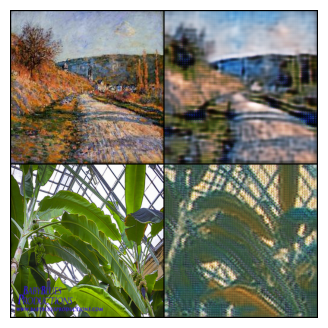

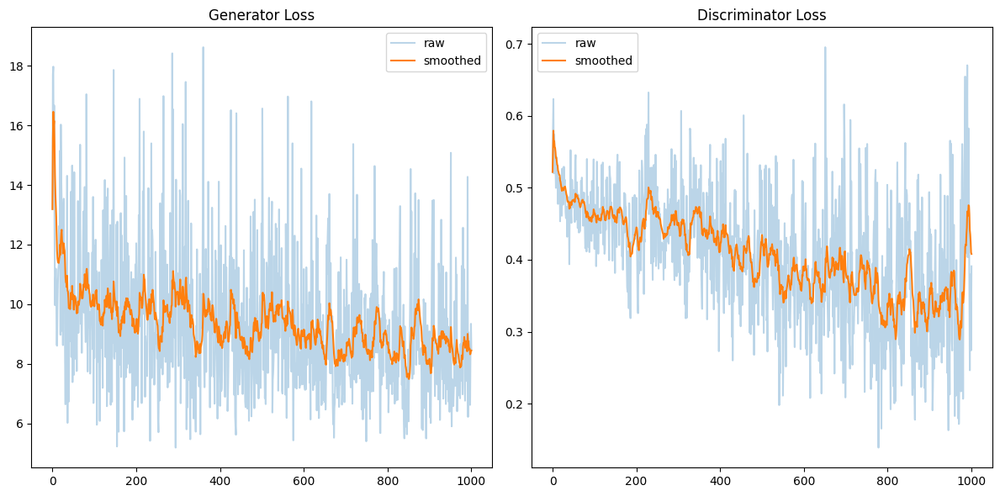

 19%|█▉        | 1200/6287 [01:55<07:57, 10.66it/s, M_fake=0.415, M_real=0.585]

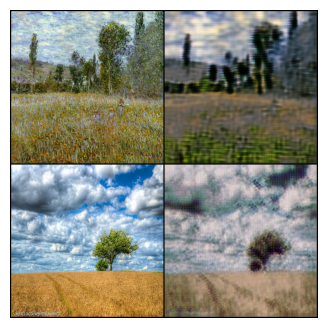

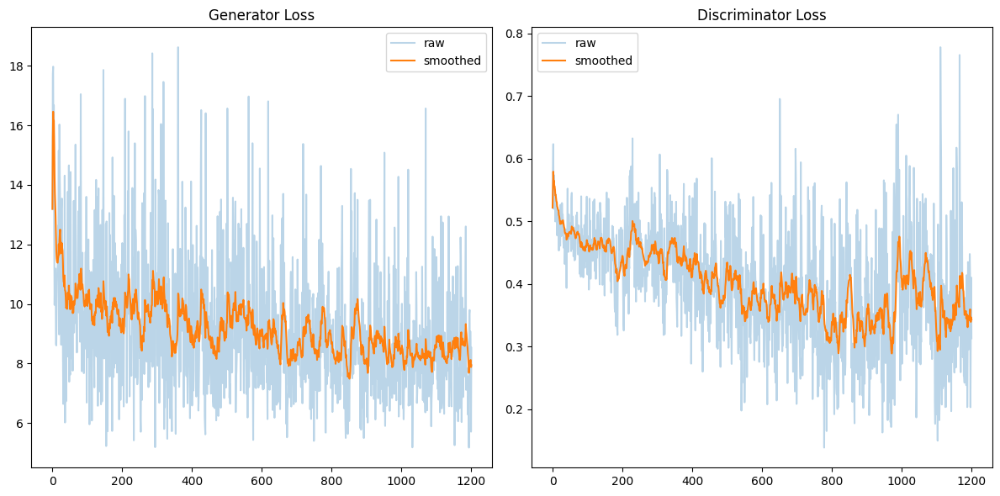

 22%|██▏       | 1400/6287 [02:13<07:18, 11.15it/s, M_fake=0.41, M_real=0.588]

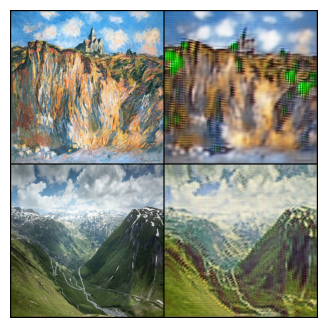

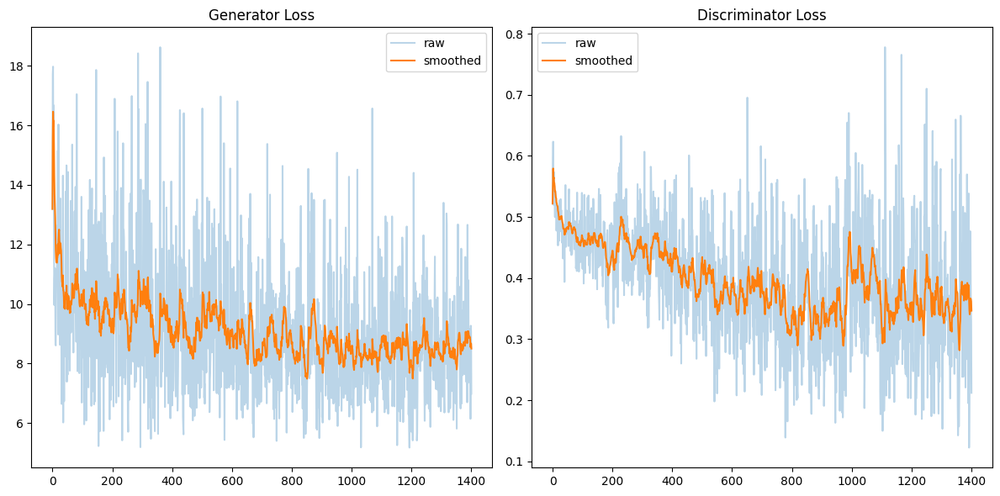

 25%|██▌       | 1600/6287 [02:32<07:07, 10.96it/s, M_fake=0.409, M_real=0.589]

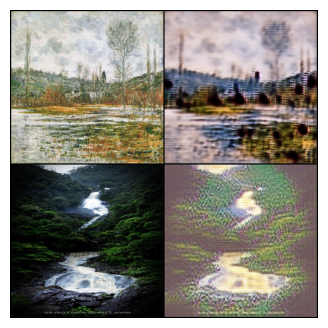

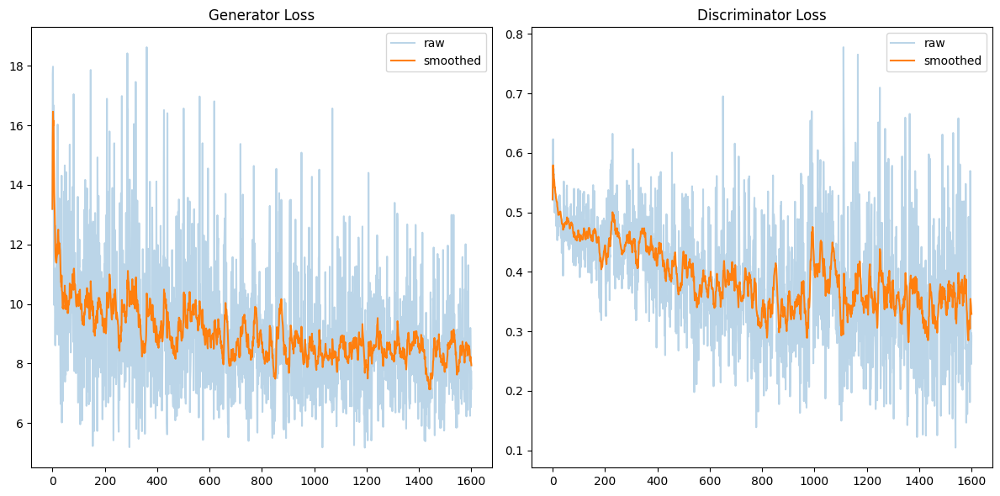

 29%|██▊       | 1800/6287 [02:51<06:49, 10.95it/s, M_fake=0.407, M_real=0.59]

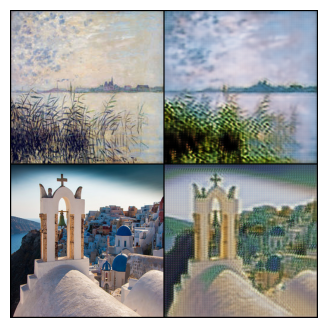

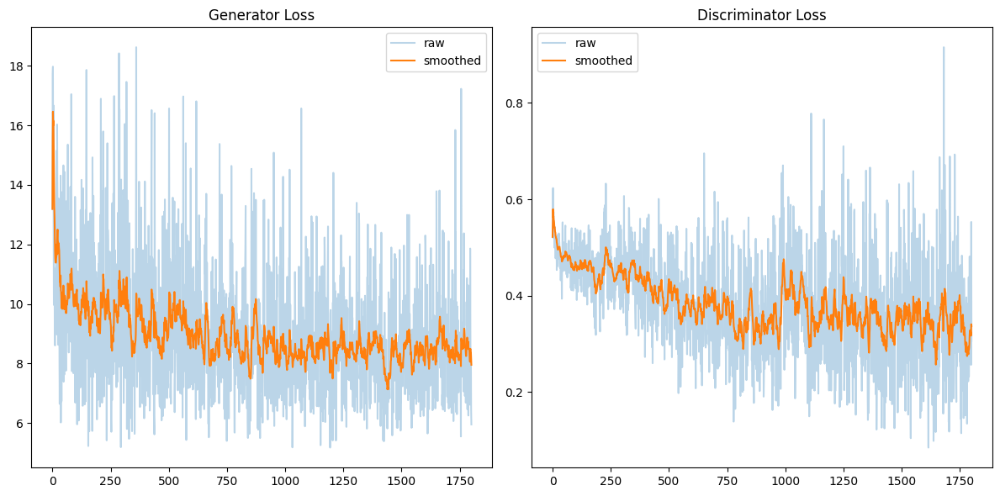

 32%|███▏      | 2000/6287 [03:09<06:38, 10.76it/s, M_fake=0.404, M_real=0.592]

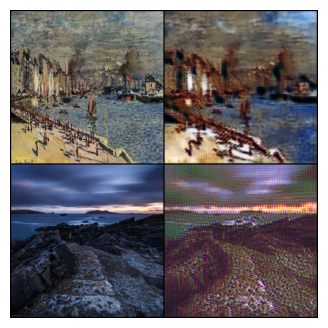

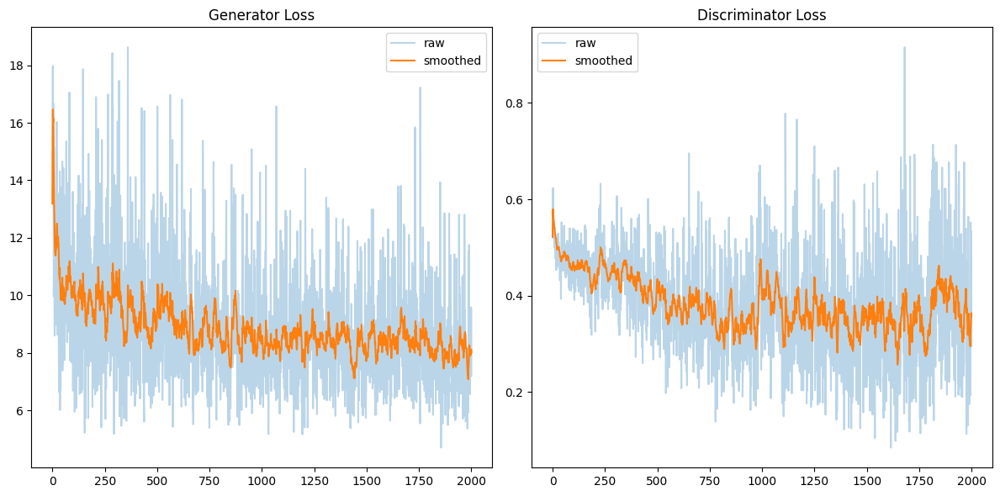

 35%|███▍      | 2200/6287 [03:28<06:11, 11.01it/s, M_fake=0.401, M_real=0.593]

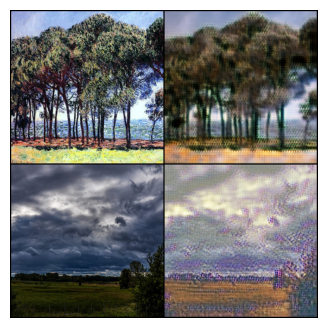

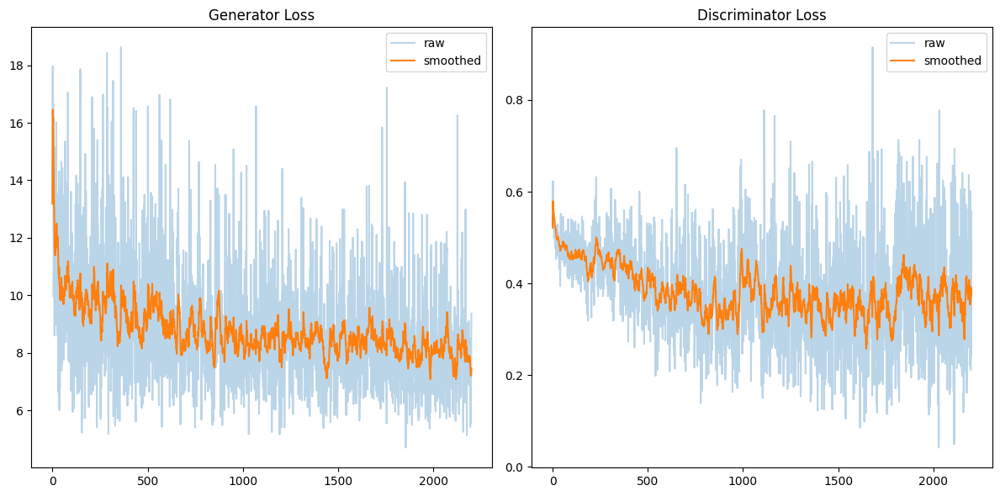

 38%|███▊      | 2400/6287 [03:47<05:46, 11.22it/s, M_fake=0.4, M_real=0.593]

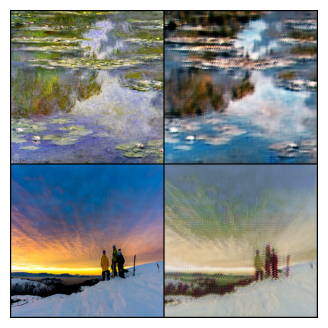

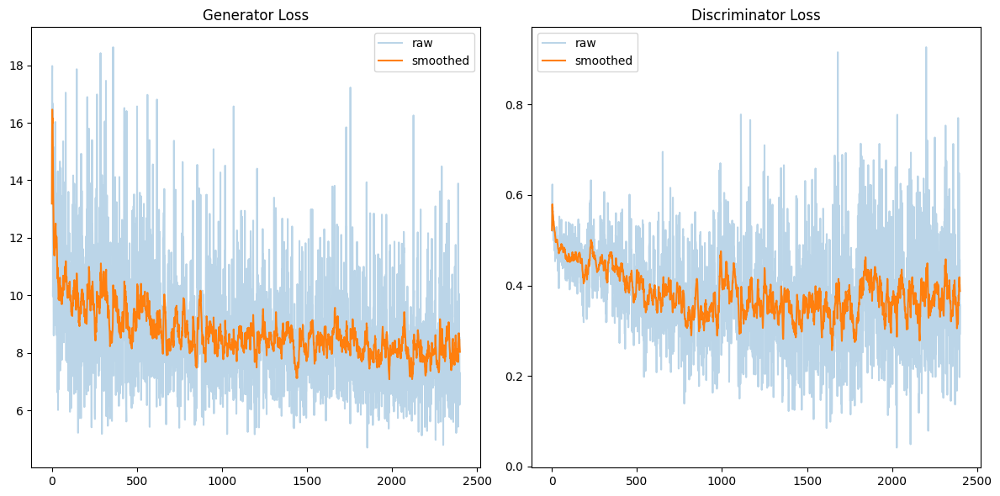

 41%|████▏     | 2600/6287 [04:06<05:33, 11.07it/s, M_fake=0.399, M_real=0.595]

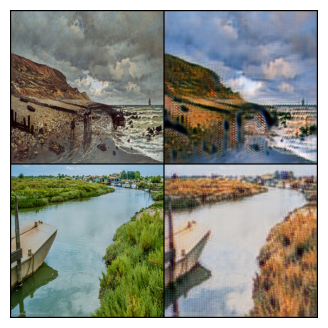

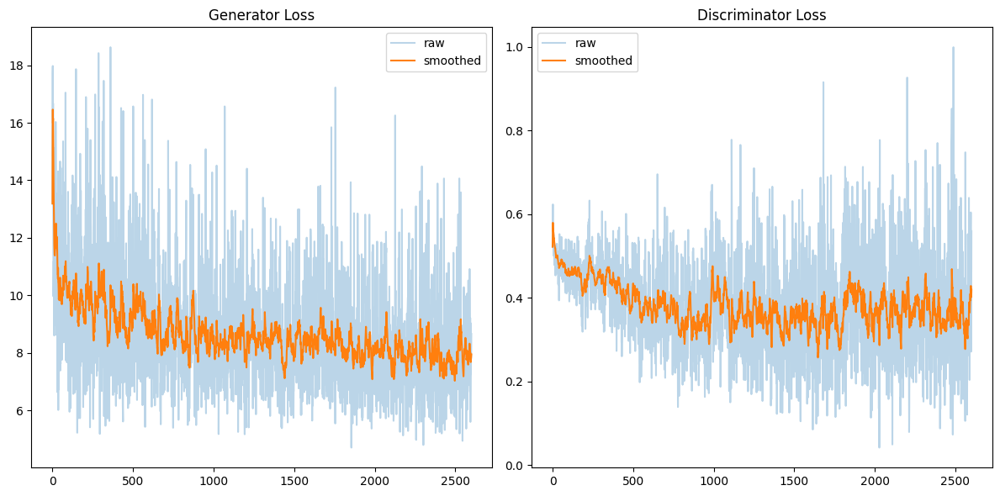

 45%|████▍     | 2799/6287 [04:25<05:14, 11.07it/s, M_fake=0.398, M_real=0.595]

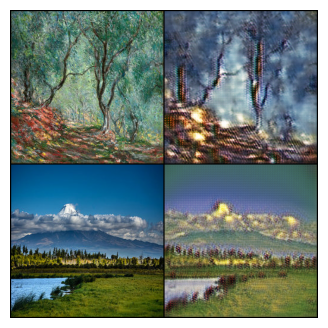

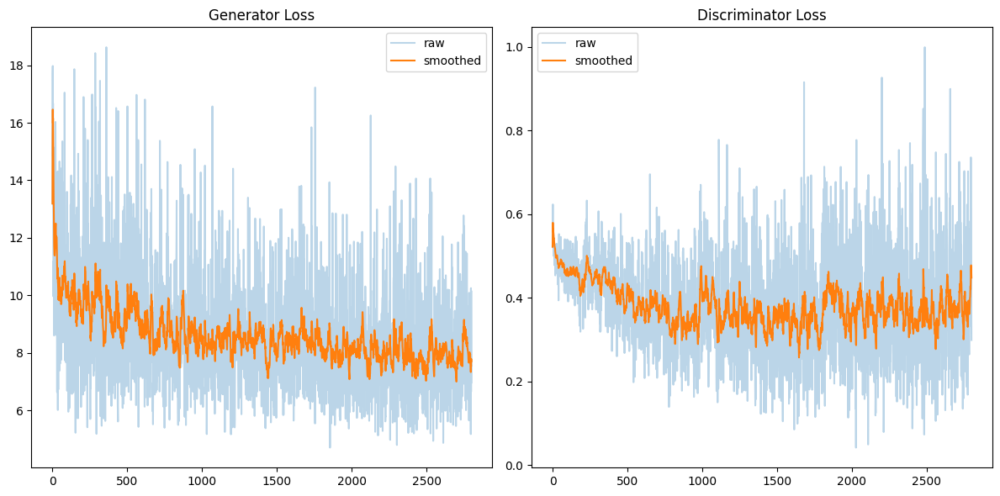

 48%|████▊     | 2999/6287 [04:44<04:54, 11.17it/s, M_fake=0.397, M_real=0.597]

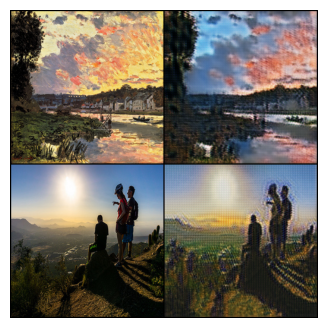

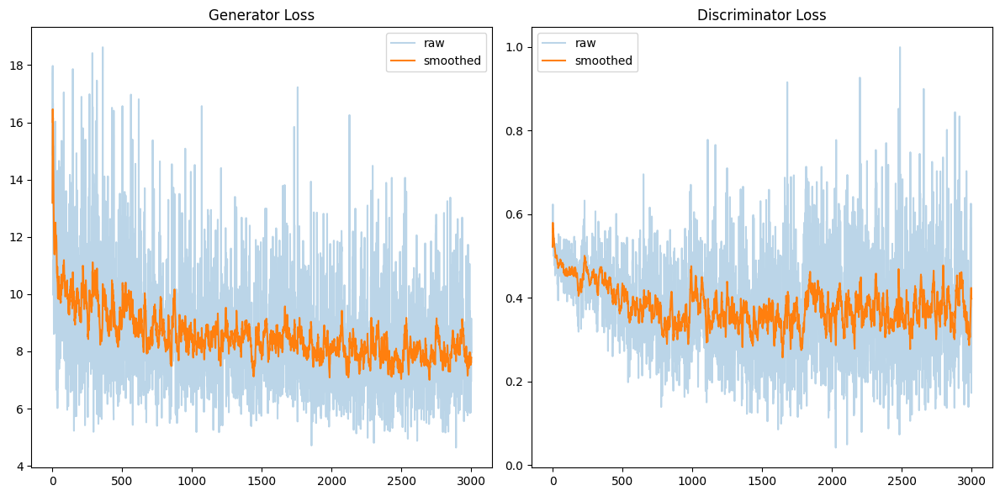

 51%|█████     | 3199/6287 [05:02<04:38, 11.08it/s, M_fake=0.395, M_real=0.598]

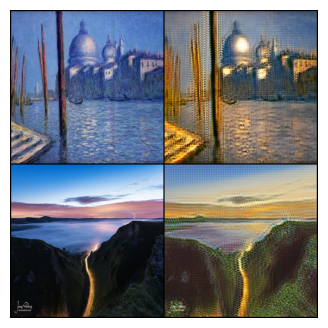

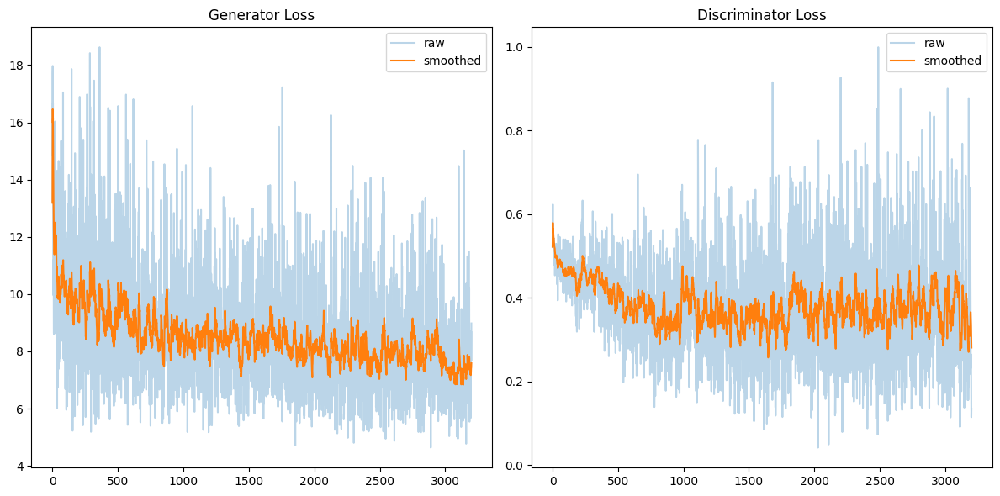

 54%|█████▍    | 3399/6287 [05:21<04:22, 10.99it/s, M_fake=0.395, M_real=0.598]

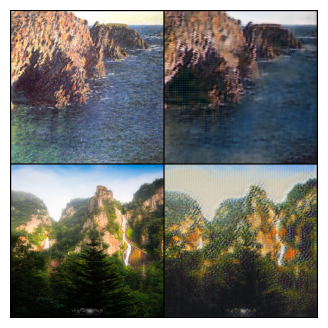

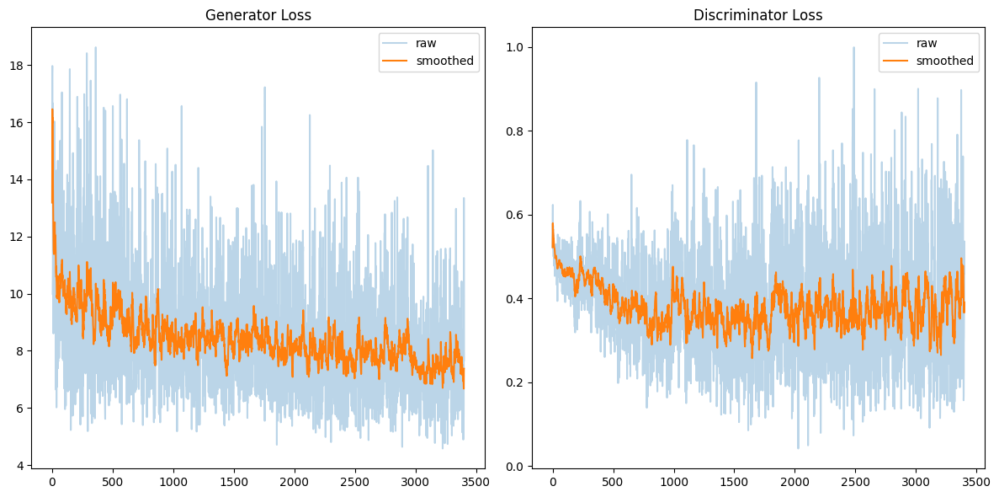

 57%|█████▋    | 3599/6287 [05:40<04:00, 11.16it/s, M_fake=0.393, M_real=0.598]

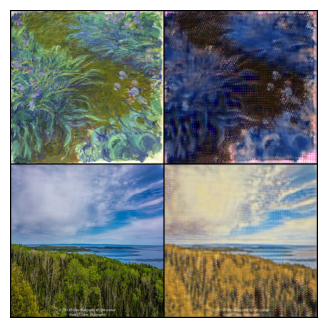

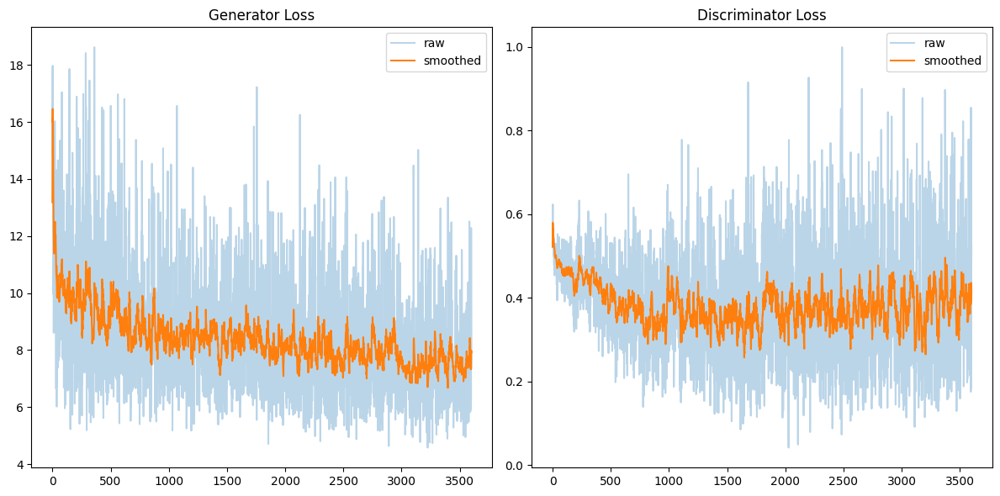

 60%|██████    | 3800/6287 [05:58<03:49, 10.82it/s, M_fake=0.392, M_real=0.598]

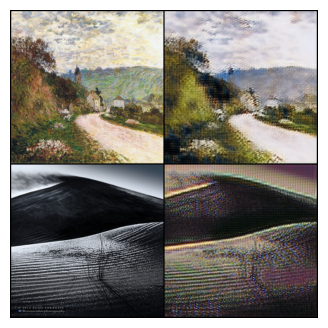

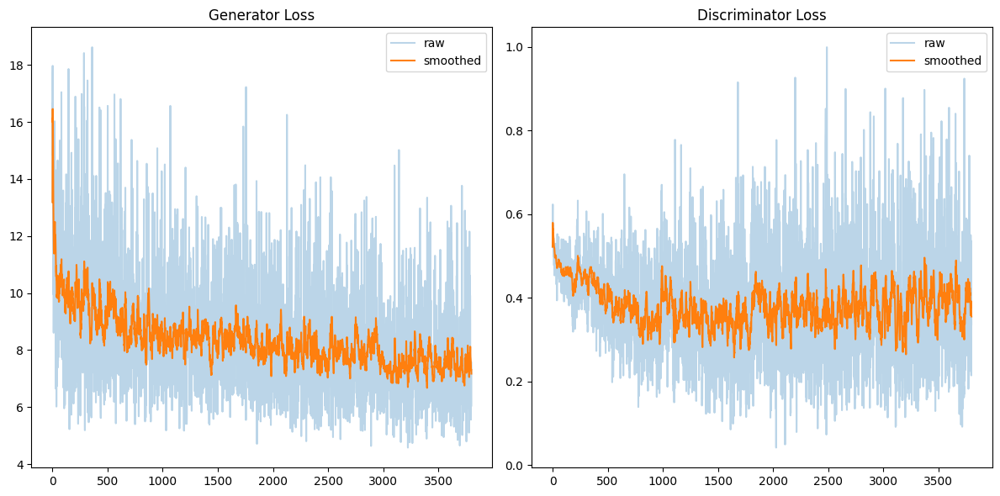

 64%|██████▎   | 3999/6287 [06:17<03:25, 11.14it/s, M_fake=0.391, M_real=0.599]

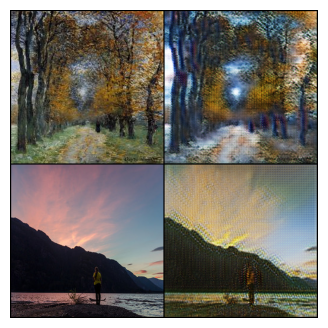

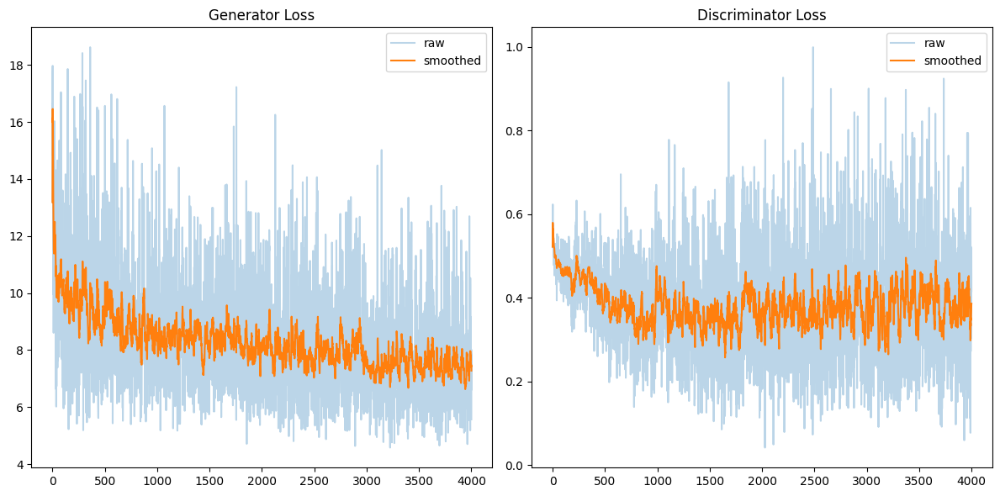

 67%|██████▋   | 4199/6287 [06:36<03:12, 10.83it/s, M_fake=0.391, M_real=0.599]

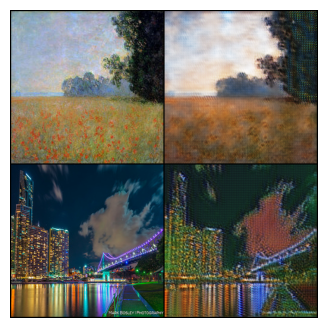

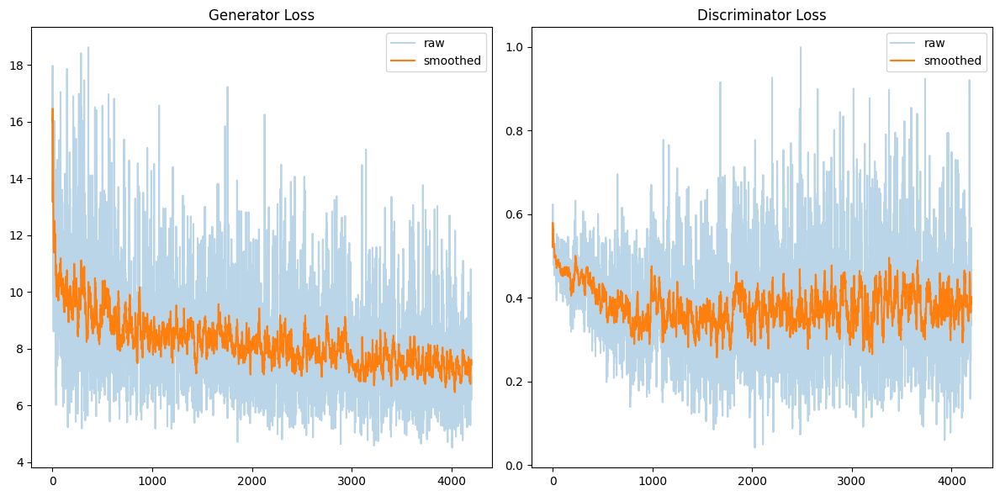

 70%|██████▉   | 4399/6287 [06:55<02:47, 11.24it/s, M_fake=0.391, M_real=0.598]

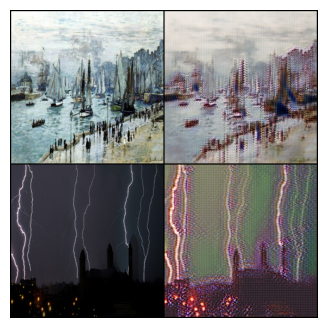

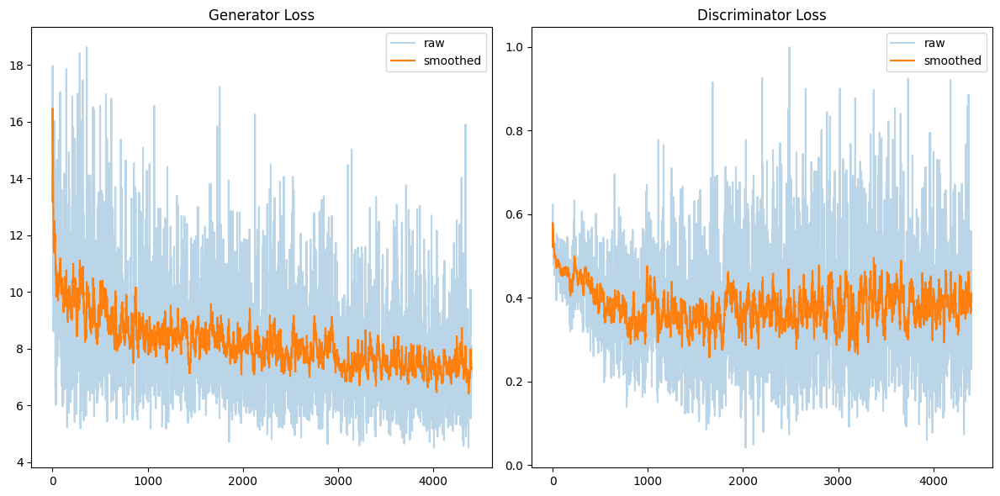

 73%|███████▎  | 4599/6287 [07:13<02:35, 10.83it/s, M_fake=0.391, M_real=0.598]

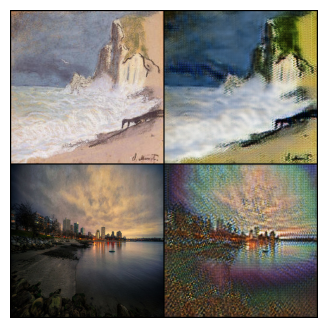

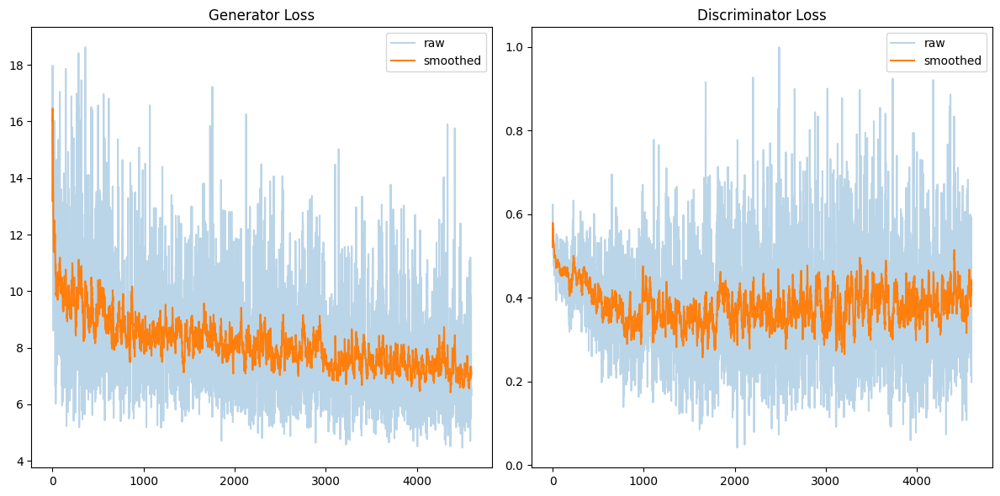

 76%|███████▋  | 4799/6287 [07:32<02:14, 11.06it/s, M_fake=0.39, M_real=0.598]

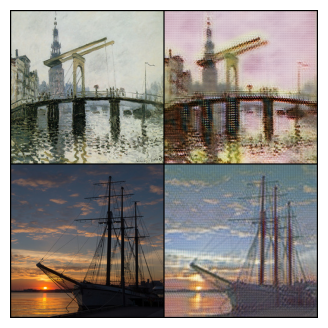

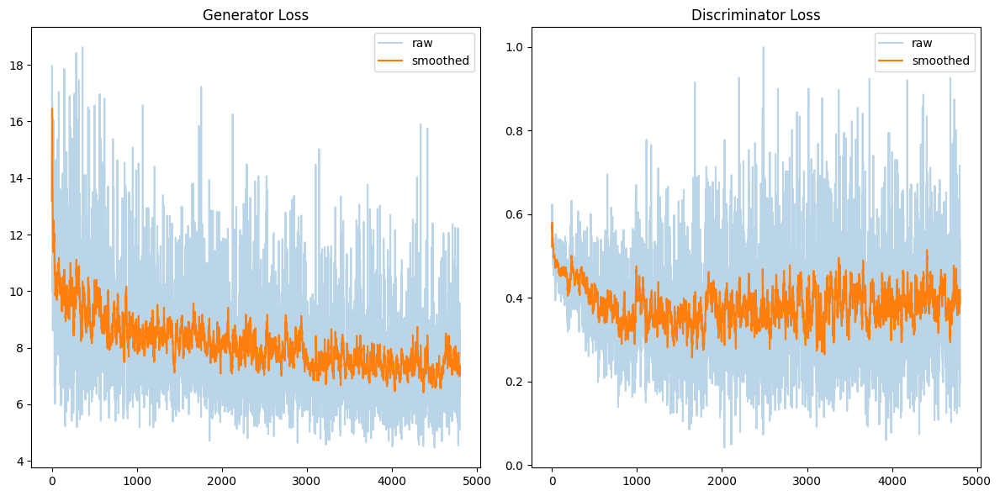

 80%|███████▉  | 4999/6287 [07:51<01:55, 11.12it/s, M_fake=0.39, M_real=0.599]

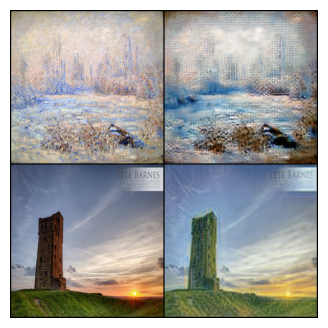

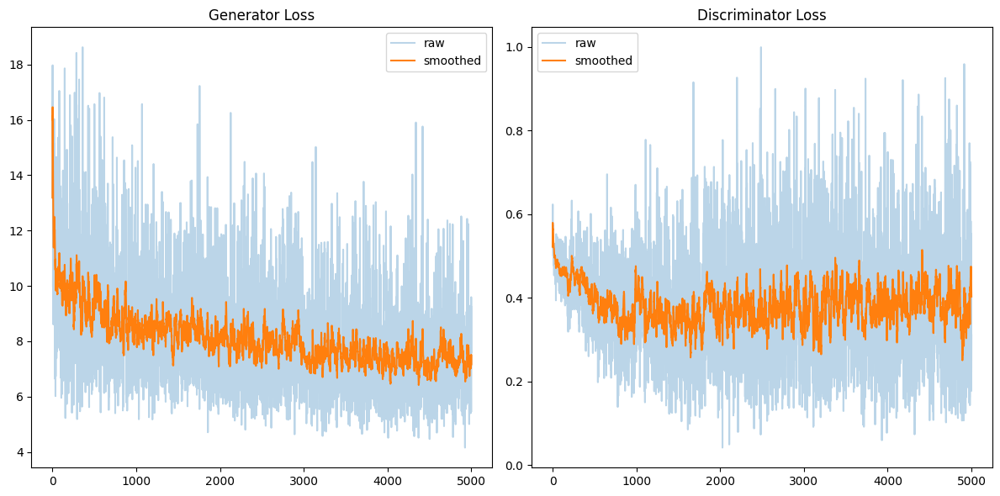

 83%|████████▎ | 5199/6287 [08:09<01:38, 11.07it/s, M_fake=0.389, M_real=0.599]

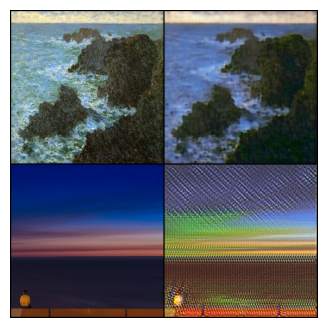

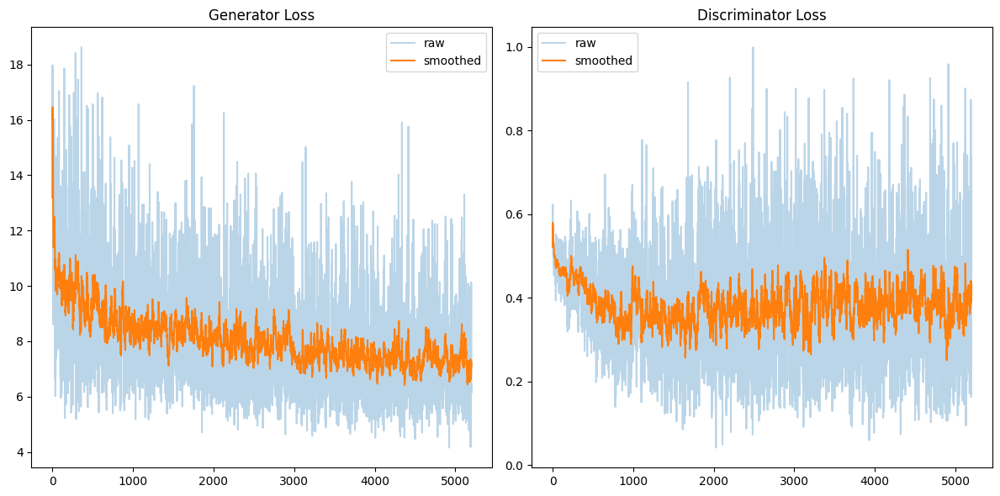

 86%|████████▌ | 5399/6287 [08:28<01:19, 11.21it/s, M_fake=0.389, M_real=0.6]

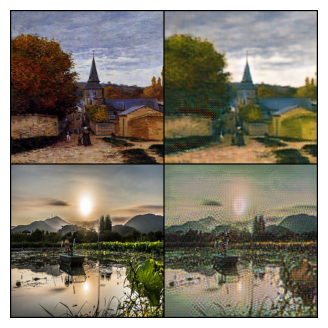

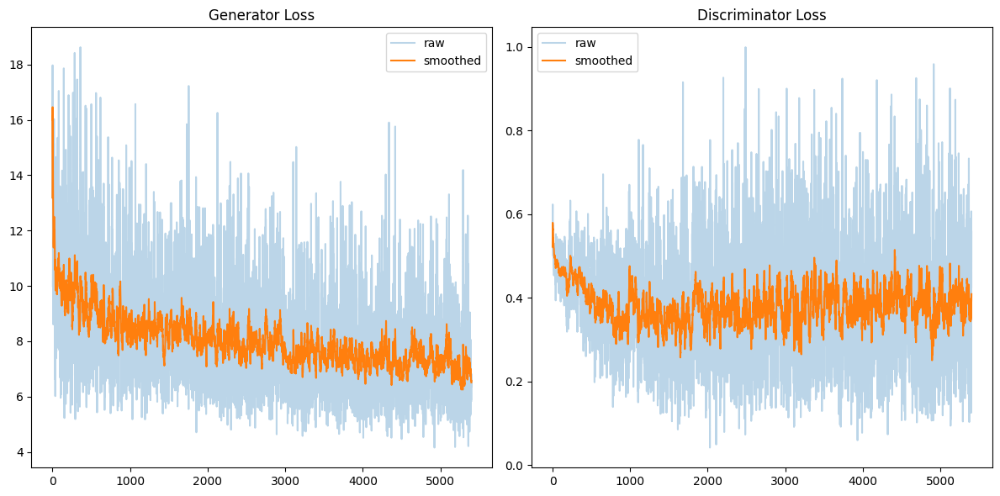

 89%|████████▉ | 5600/6287 [08:47<01:02, 11.05it/s, M_fake=0.389, M_real=0.599]

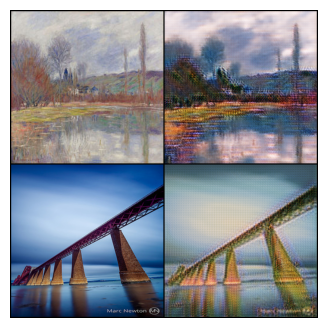

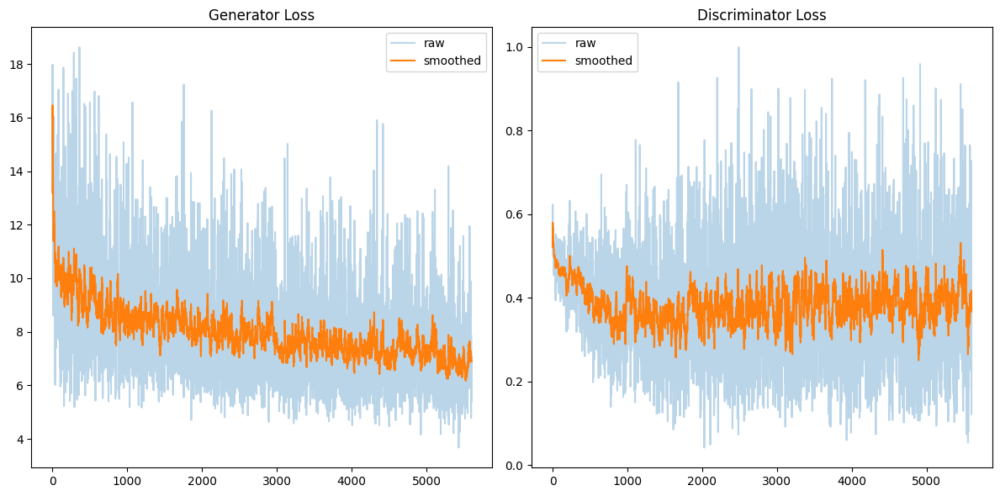

 92%|█████████▏| 5799/6287 [09:06<00:44, 11.05it/s, M_fake=0.389, M_real=0.599]

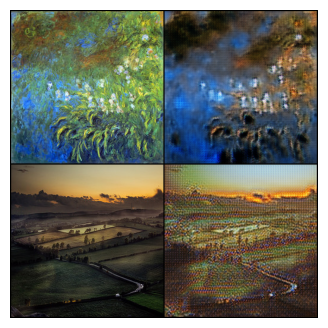

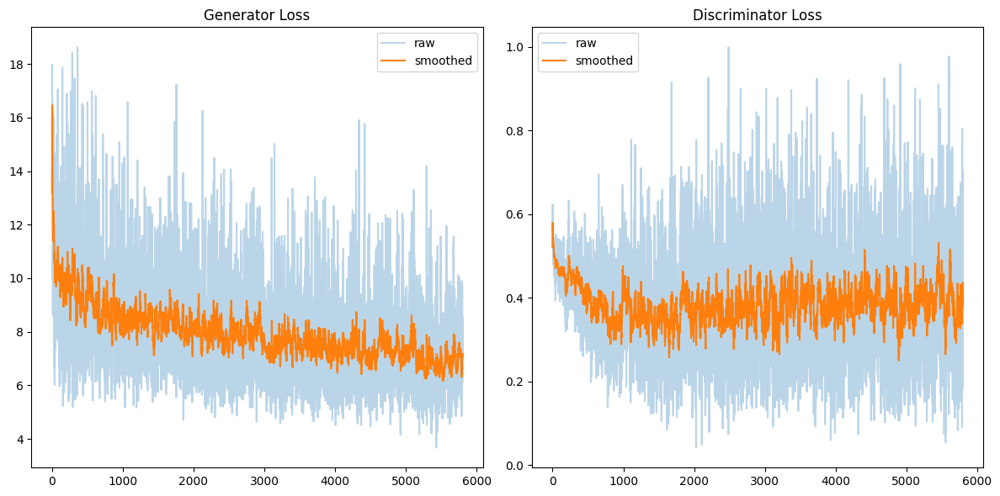

 95%|█████████▌| 5999/6287 [09:24<00:26, 10.78it/s, M_fake=0.388, M_real=0.6]

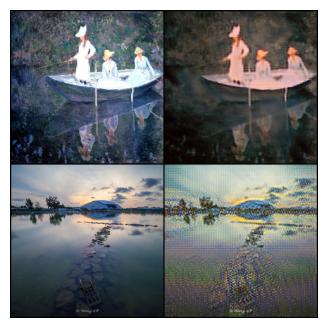

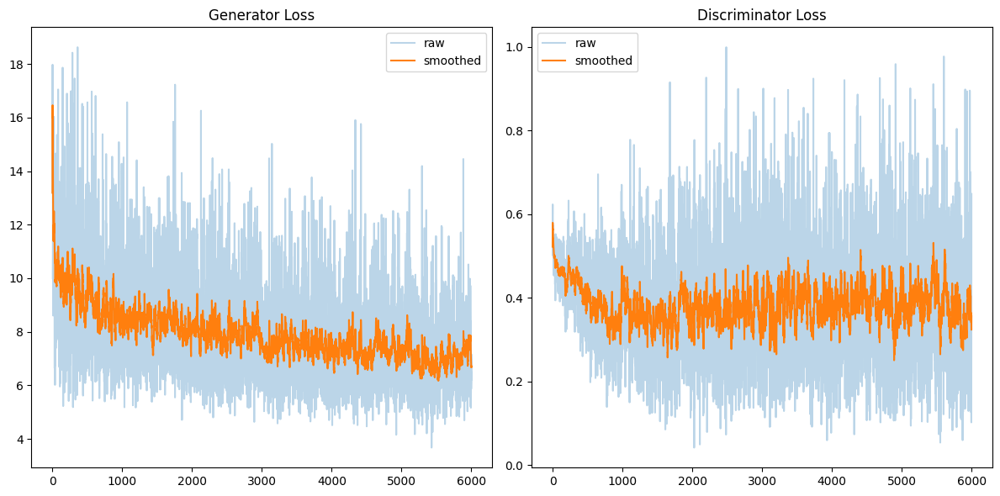

 99%|█████████▊| 6199/6287 [09:43<00:08, 10.99it/s, M_fake=0.387, M_real=0.601]

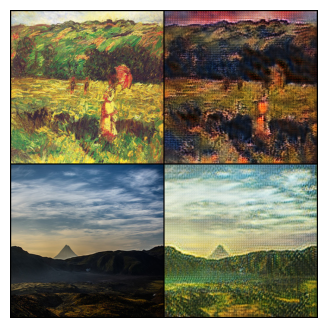

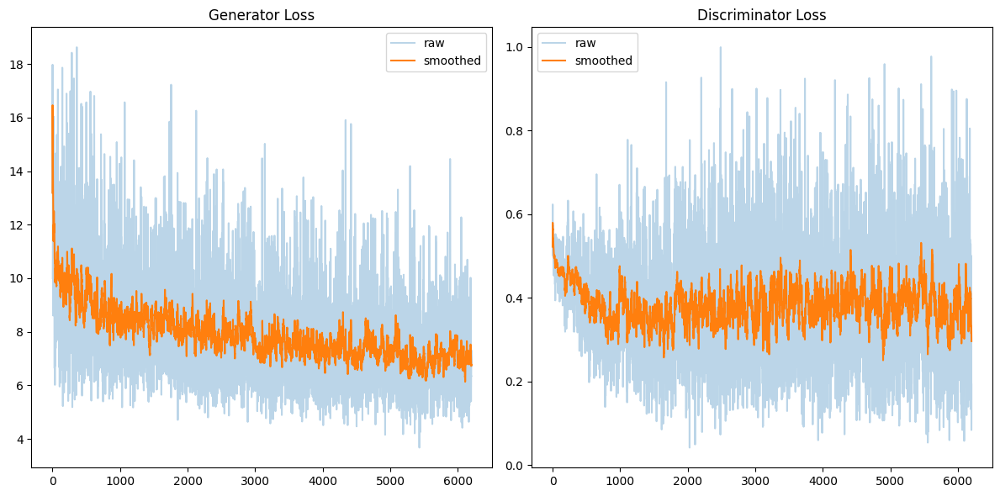

100%|██████████| 6287/6287 [09:52<00:00, 10.61it/s, M_fake=0.387, M_real=0.601]


=> Saving checkpoint
=> Saving checkpoint
=> Saving checkpoint
=> Saving checkpoint
EPOCH 1/3 finished


  0%|          | 0/6287 [00:00<?, ?it/s]

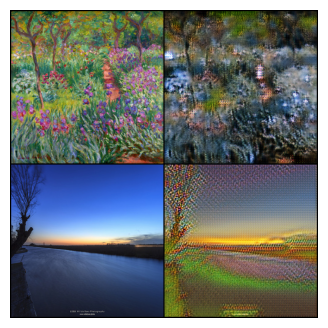

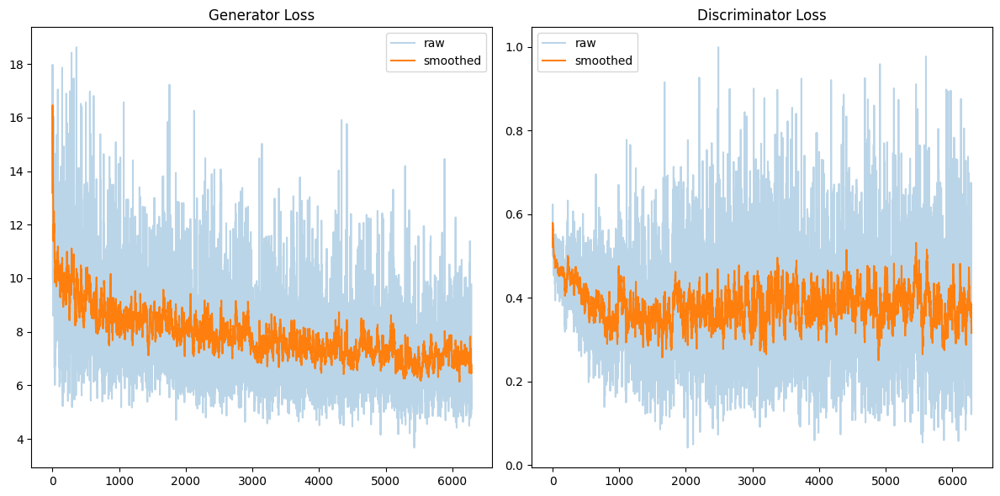

  3%|▎         | 199/6287 [00:27<09:10, 11.06it/s, M_fake=0.372, M_real=0.601]

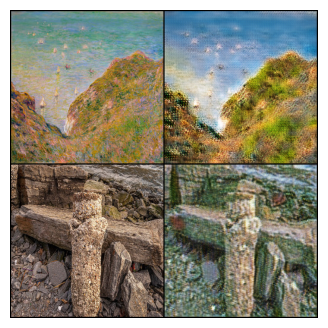

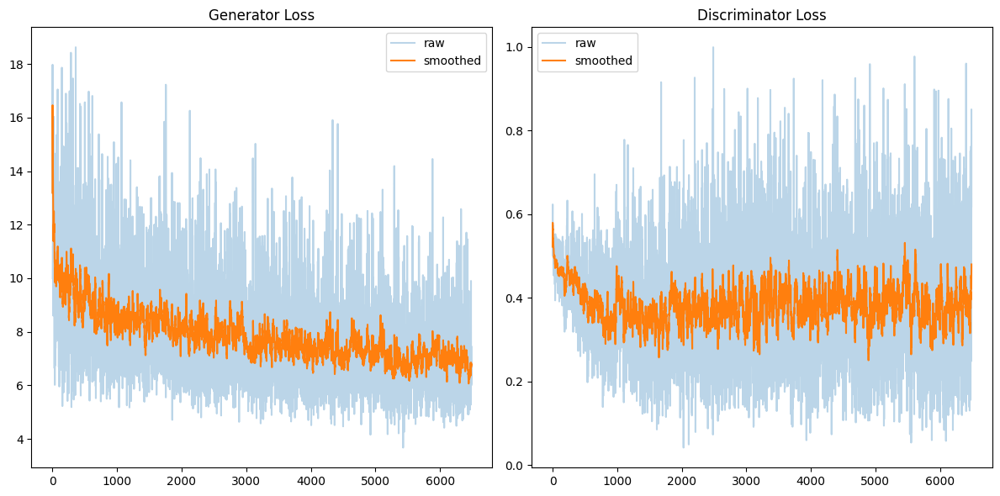

  6%|▋         | 399/6287 [00:47<08:51, 11.07it/s, M_fake=0.386, M_real=0.6]  

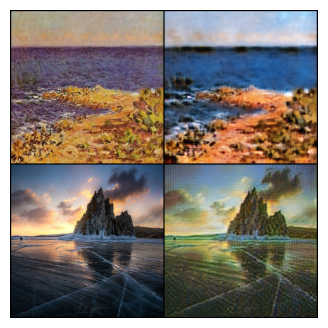

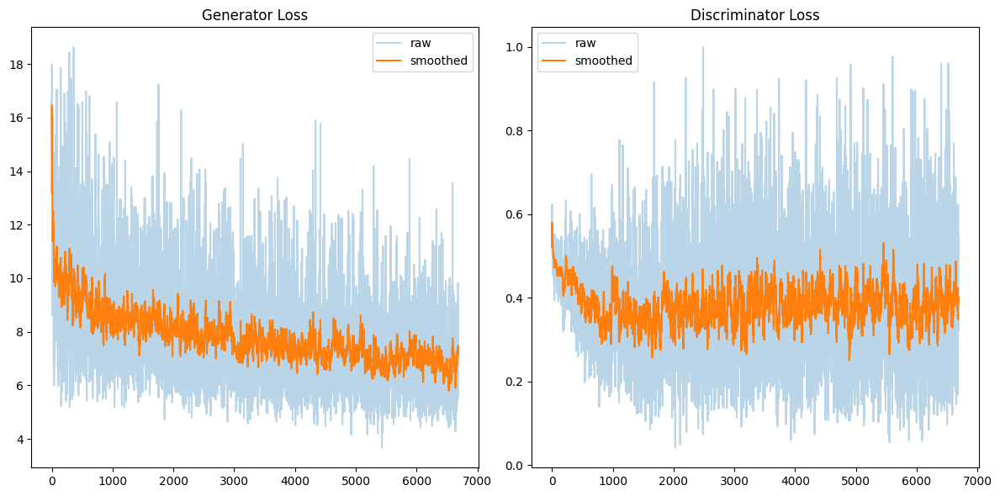

 10%|▉         | 600/6287 [01:06<08:34, 11.06it/s, M_fake=0.381, M_real=0.607]

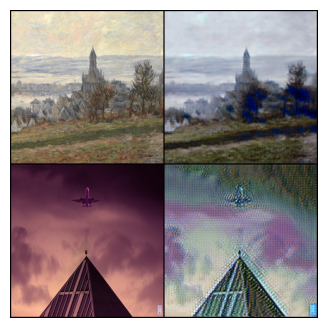

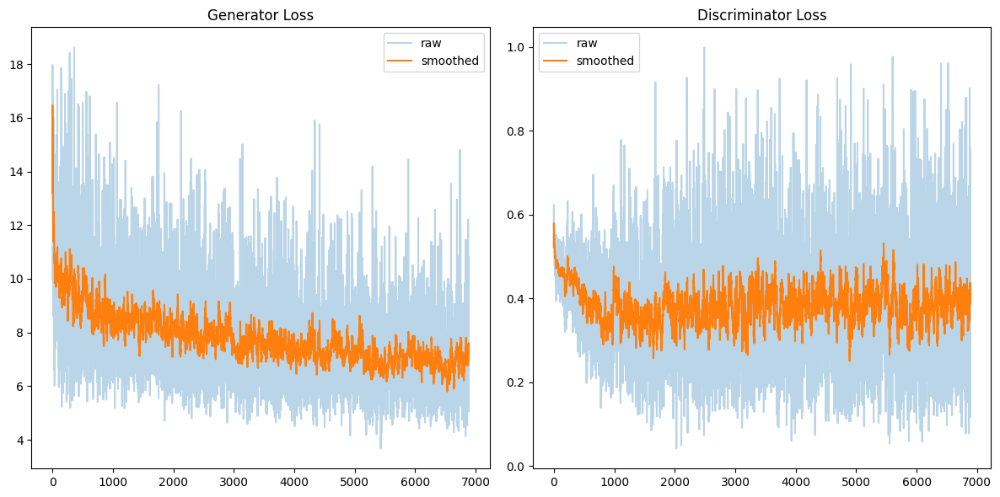

 13%|█▎        | 800/6287 [01:25<08:26, 10.84it/s, M_fake=0.379, M_real=0.608]

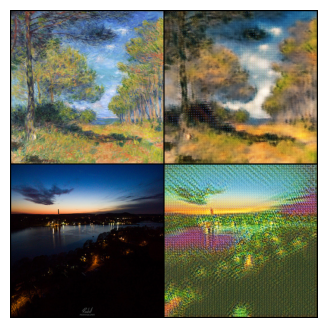

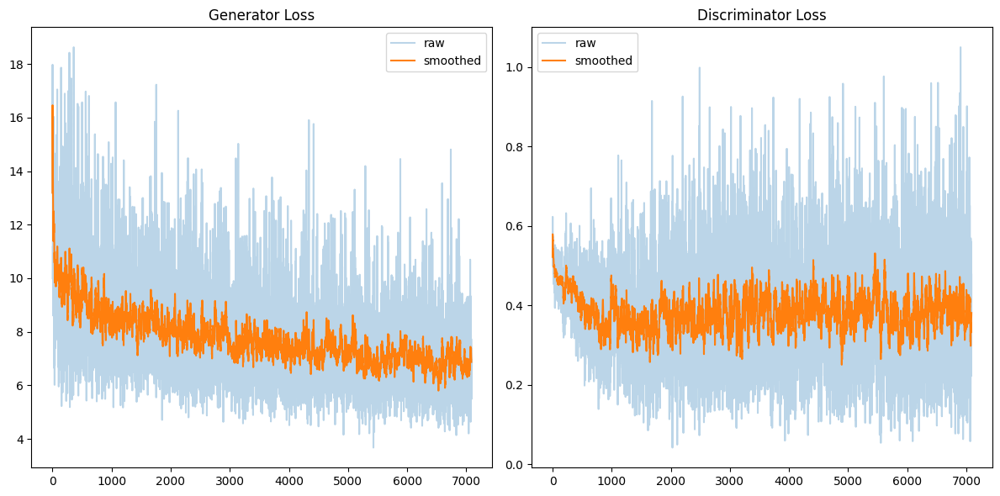

 16%|█▌        | 1000/6287 [01:44<08:05, 10.88it/s, M_fake=0.381, M_real=0.609]

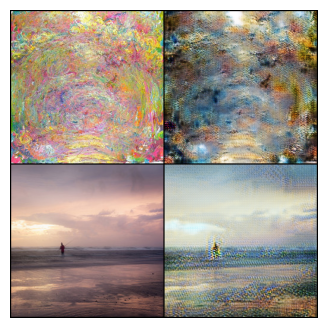

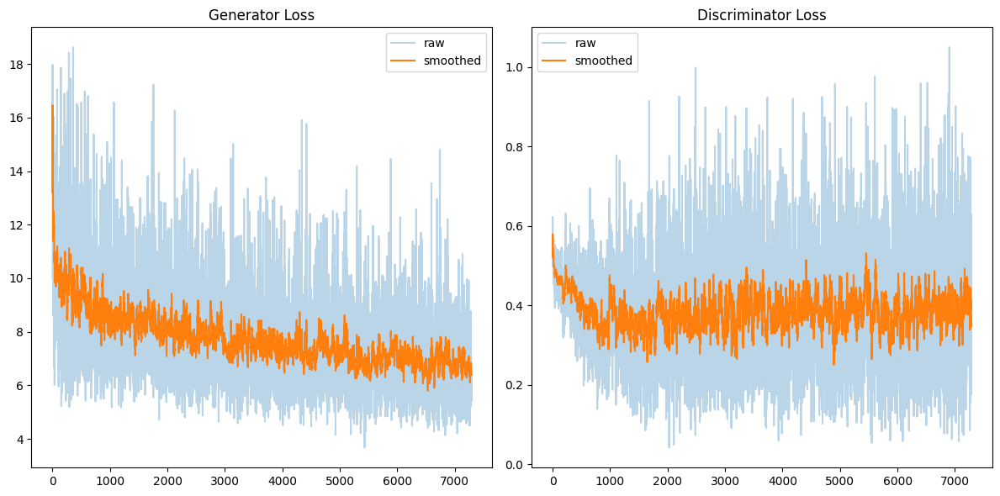

 19%|█▉        | 1200/6287 [02:03<07:38, 11.09it/s, M_fake=0.381, M_real=0.61]

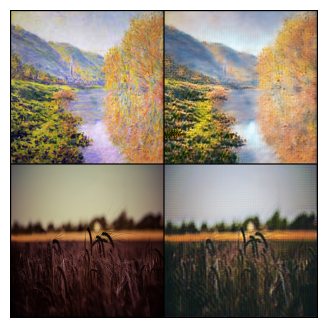

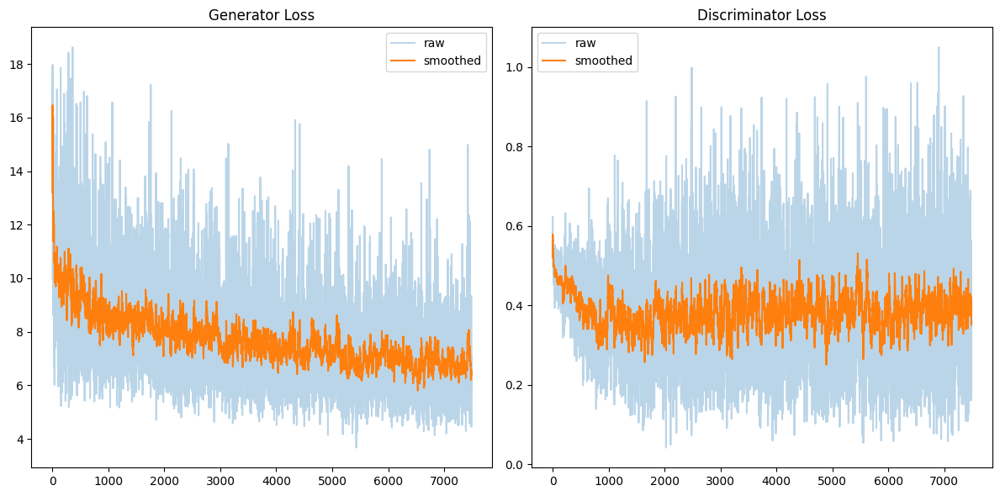

 22%|██▏       | 1400/6287 [02:22<07:25, 10.97it/s, M_fake=0.378, M_real=0.612]

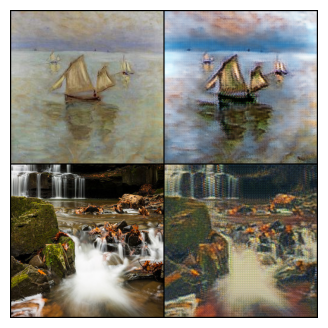

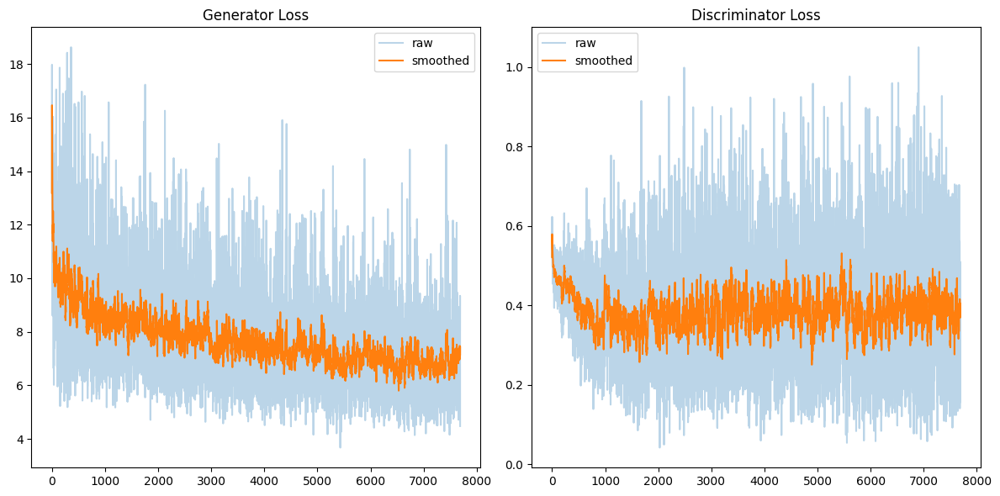

 25%|██▌       | 1600/6287 [02:41<07:01, 11.13it/s, M_fake=0.376, M_real=0.613]

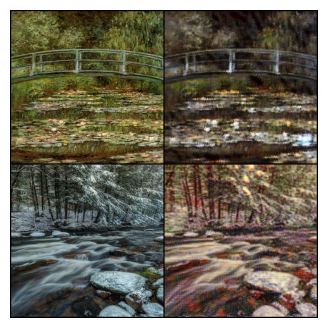

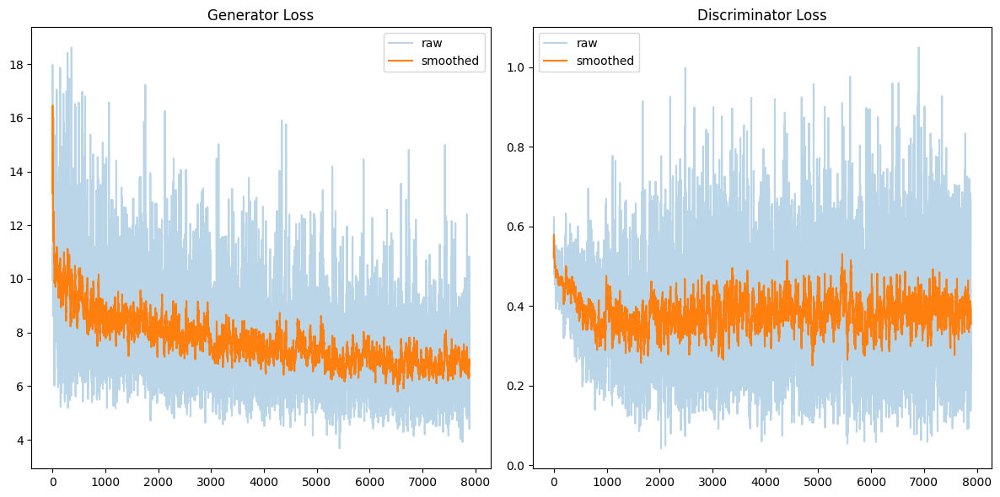

 29%|██▊       | 1800/6287 [03:00<06:40, 11.19it/s, M_fake=0.376, M_real=0.613]

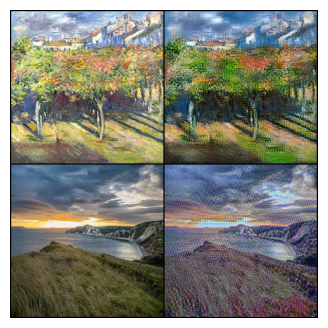

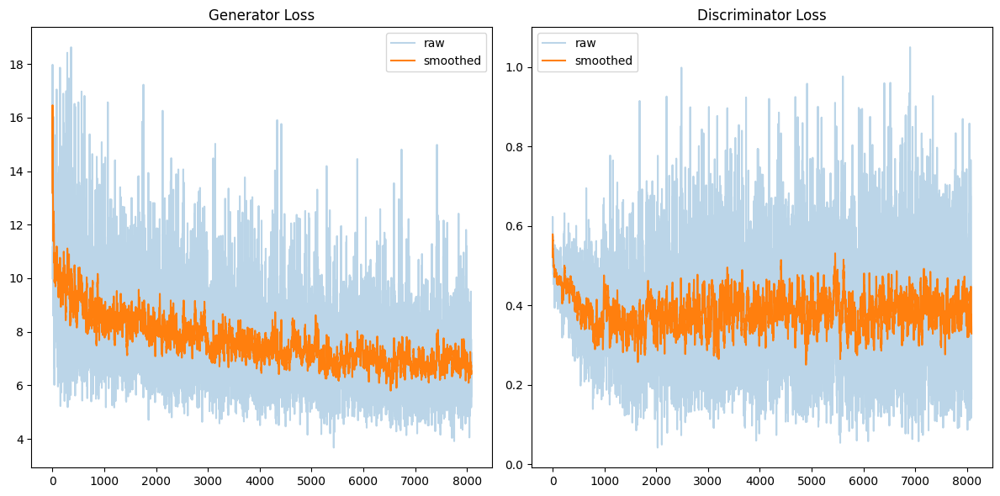

 32%|███▏      | 2000/6287 [03:18<06:29, 11.01it/s, M_fake=0.376, M_real=0.612]

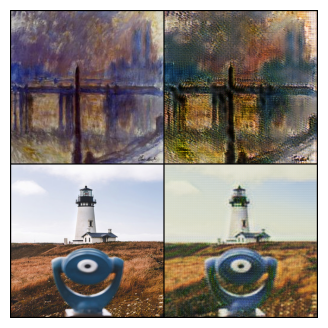

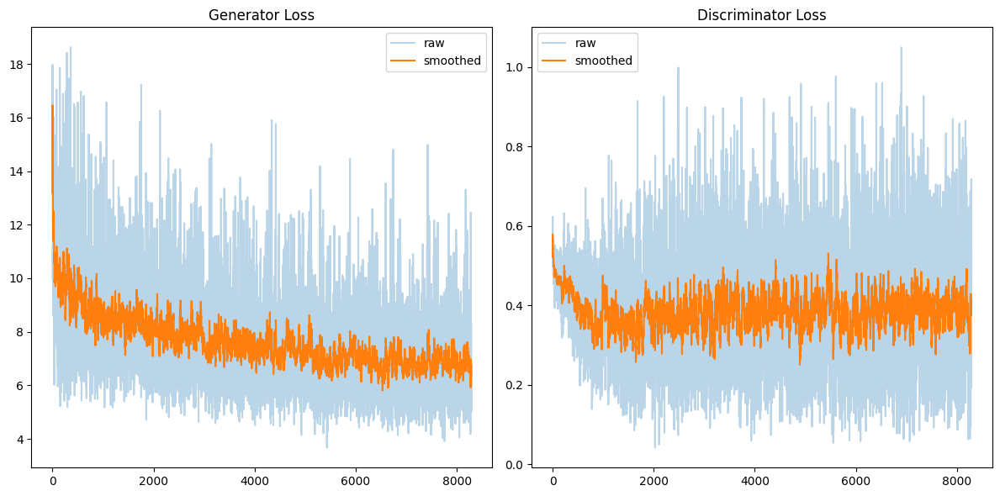

 35%|███▍      | 2200/6287 [03:37<06:14, 10.91it/s, M_fake=0.377, M_real=0.612]

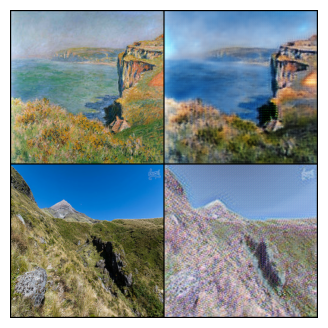

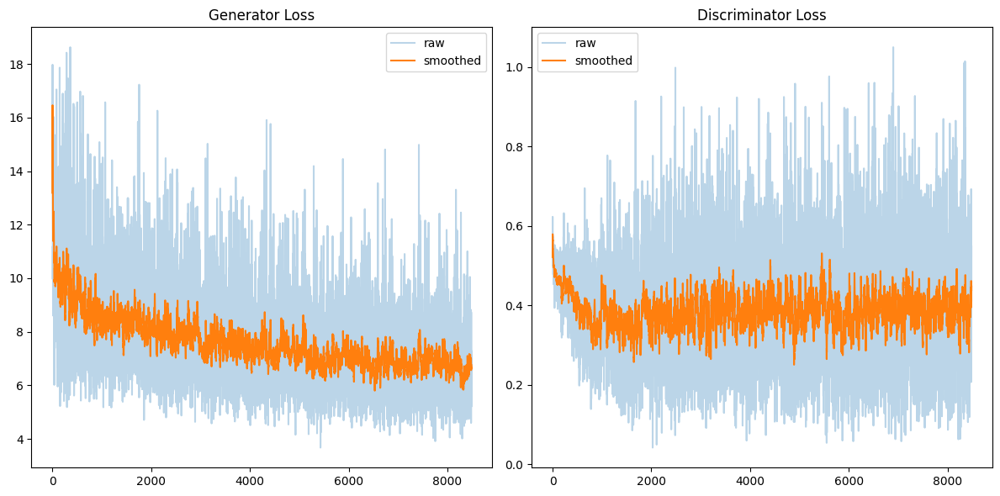

 38%|███▊      | 2400/6287 [03:56<05:52, 11.02it/s, M_fake=0.378, M_real=0.612]

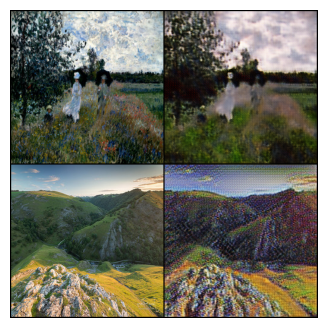

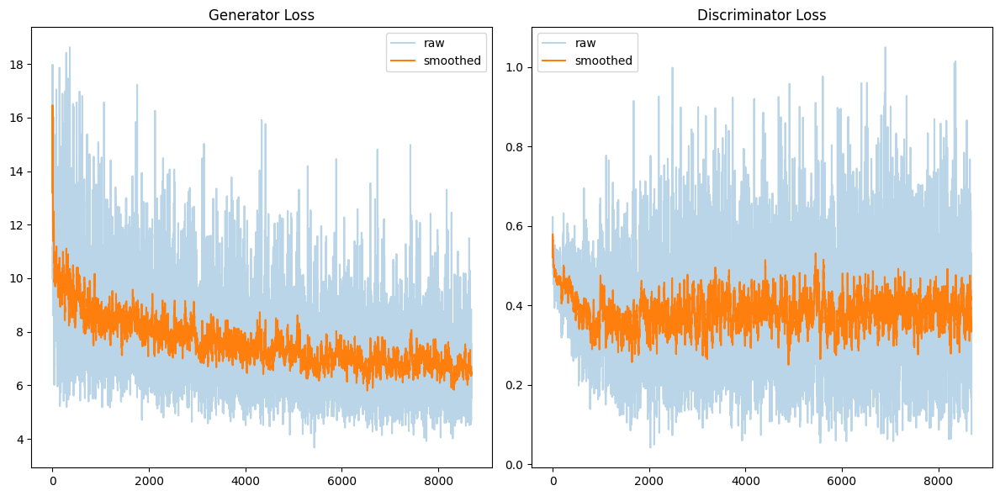

 41%|████▏     | 2599/6287 [04:15<05:36, 10.97it/s, M_fake=0.379, M_real=0.612]

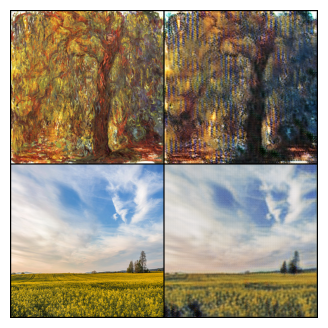

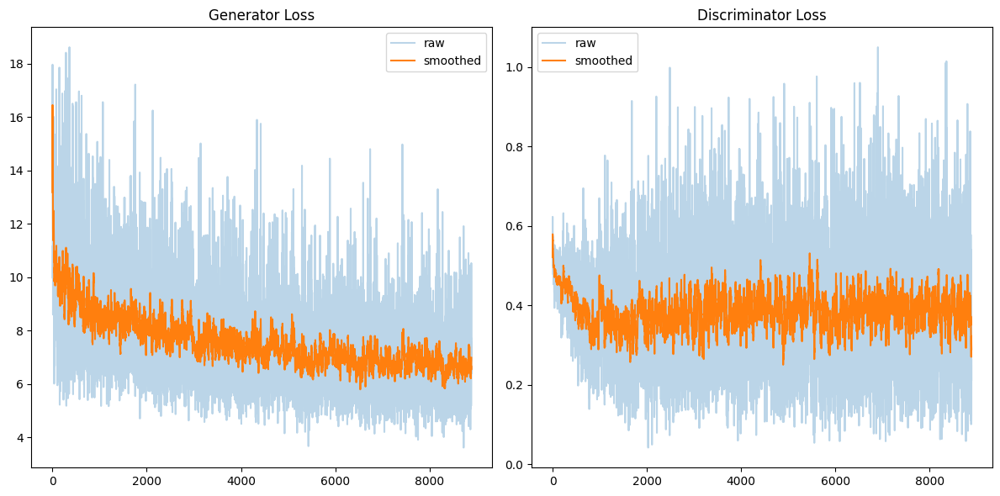

 45%|████▍     | 2800/6287 [04:34<05:21, 10.85it/s, M_fake=0.378, M_real=0.613]

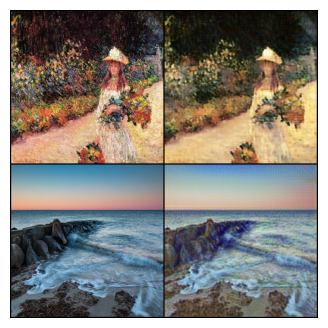

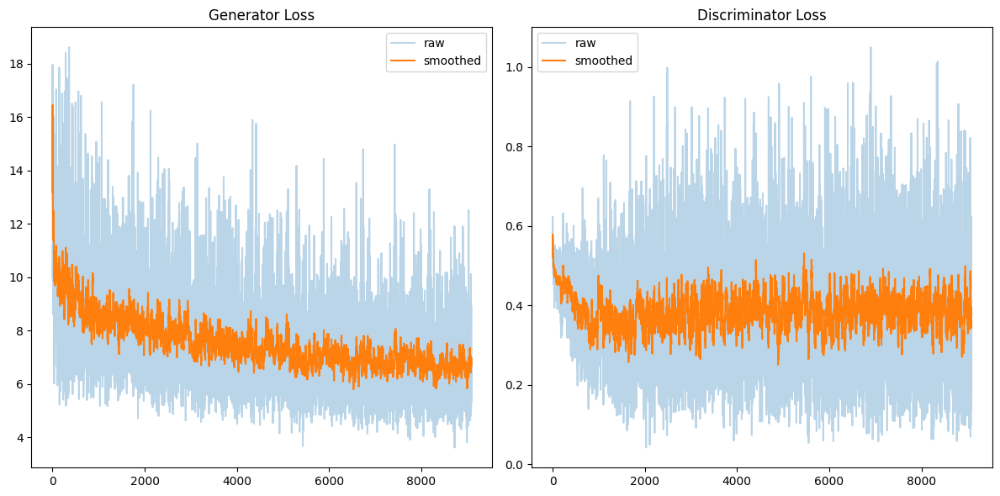

 48%|████▊     | 3000/6287 [04:53<04:59, 10.96it/s, M_fake=0.379, M_real=0.613]

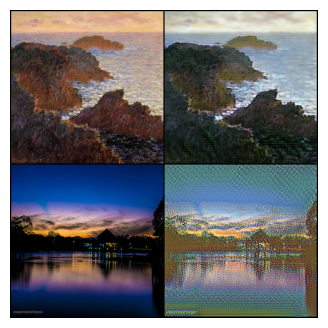

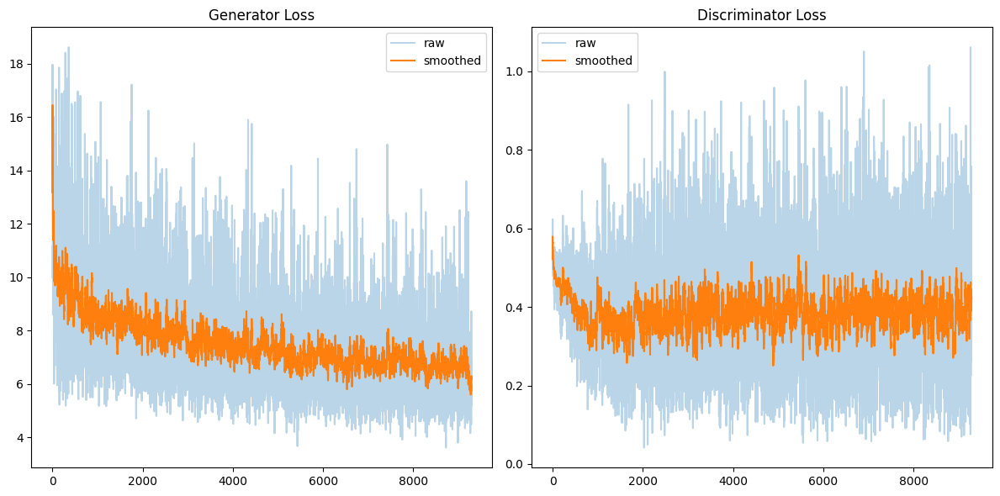

 51%|█████     | 3200/6287 [05:12<04:50, 10.63it/s, M_fake=0.38, M_real=0.612]

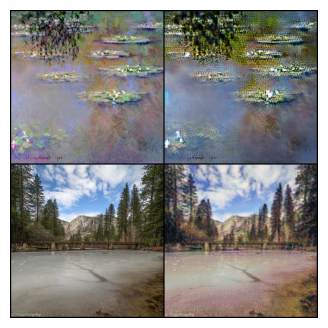

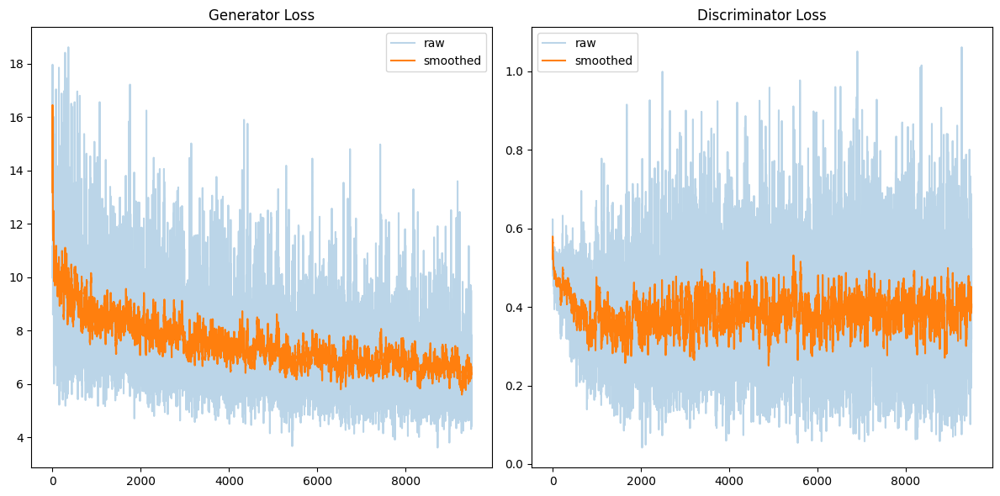

 54%|█████▍    | 3400/6287 [05:31<04:19, 11.12it/s, M_fake=0.381, M_real=0.611]

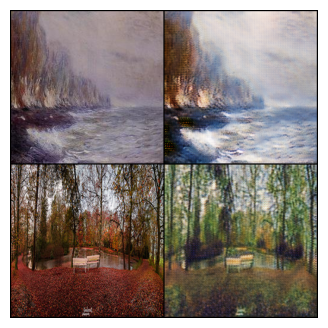

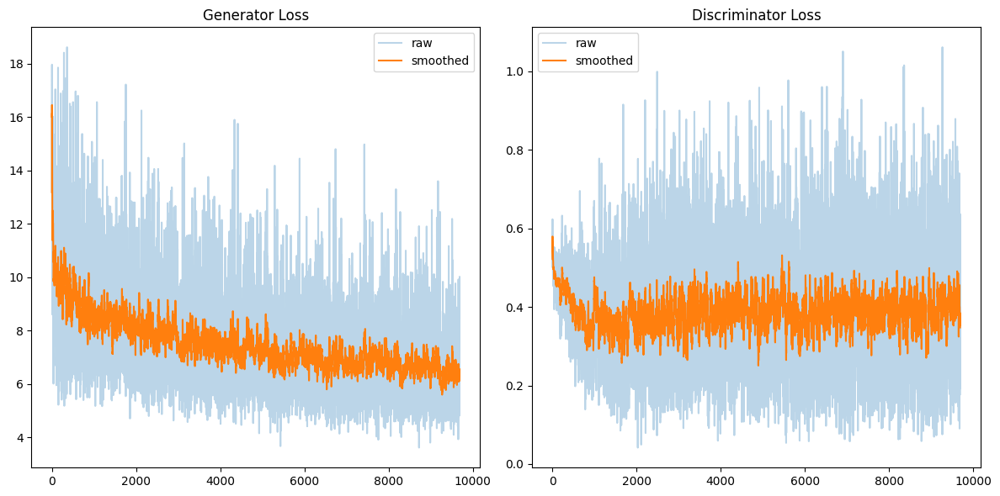

 57%|█████▋    | 3600/6287 [05:50<04:04, 10.97it/s, M_fake=0.381, M_real=0.611]

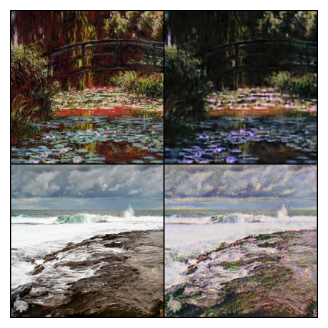

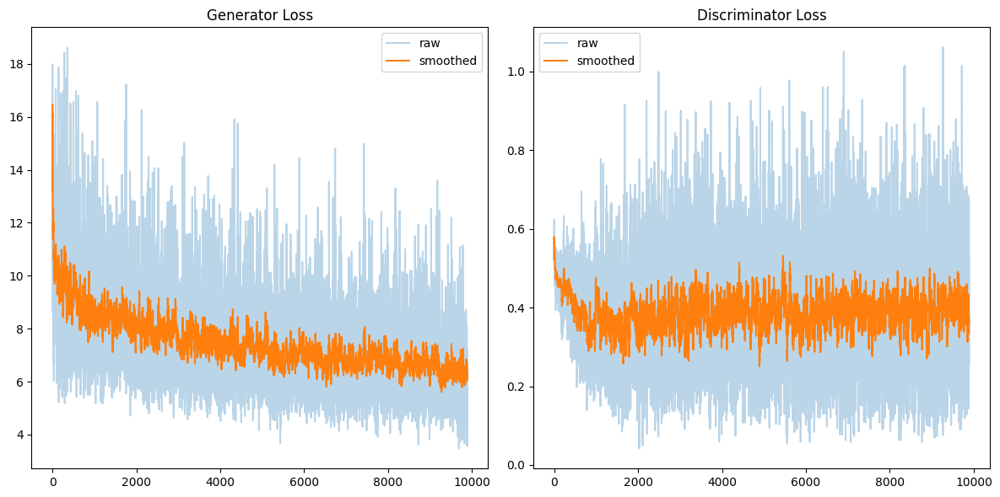

 60%|██████    | 3800/6287 [06:09<03:47, 10.91it/s, M_fake=0.379, M_real=0.613]

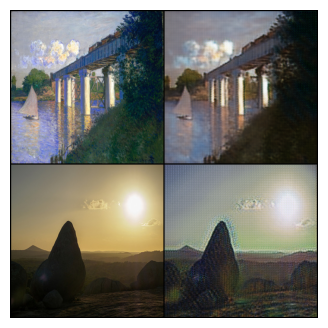

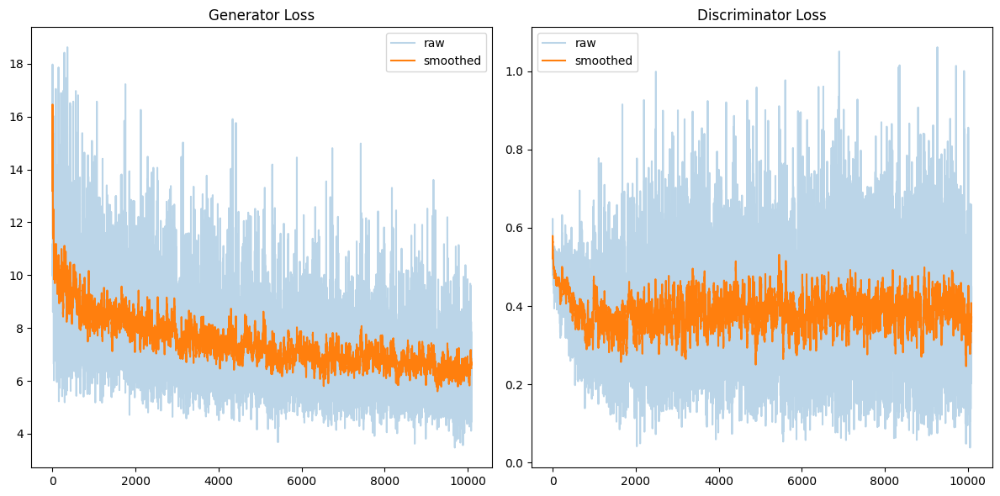

 64%|██████▎   | 4000/6287 [06:28<03:27, 11.04it/s, M_fake=0.379, M_real=0.614]

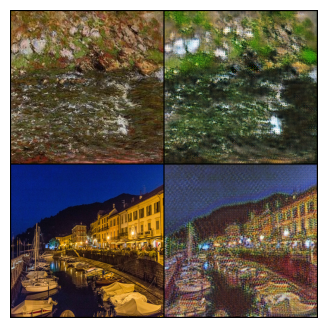

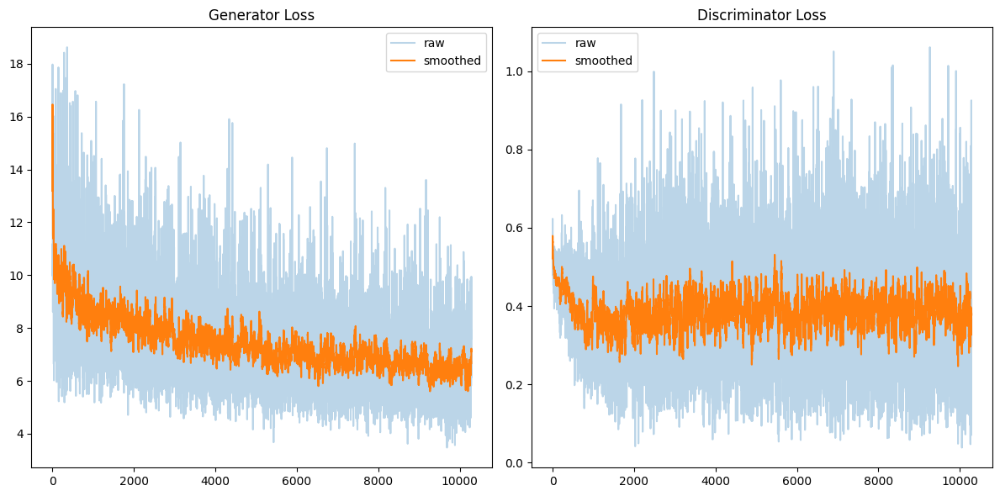

 67%|██████▋   | 4200/6287 [06:47<03:13, 10.80it/s, M_fake=0.38, M_real=0.613]

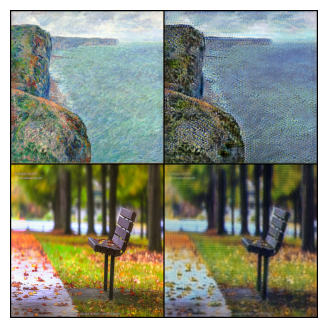

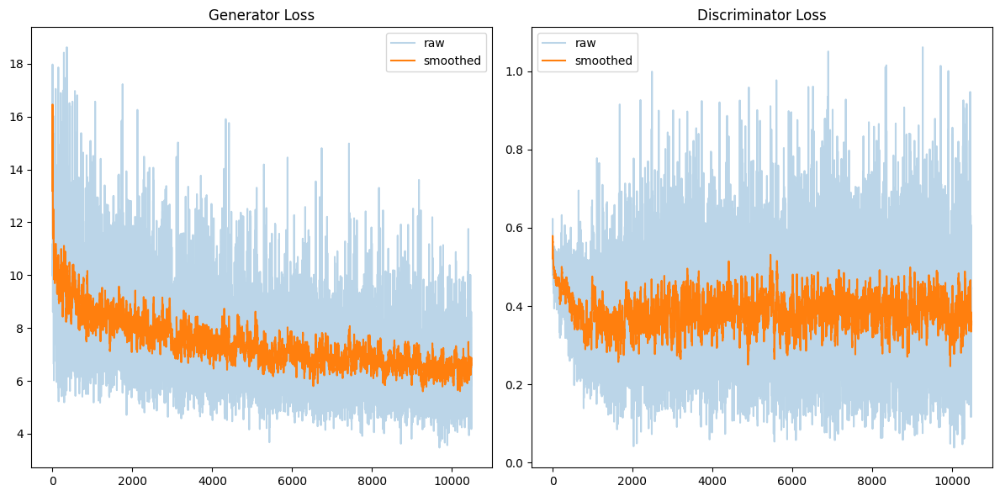

 70%|██████▉   | 4399/6287 [07:05<02:49, 11.11it/s, M_fake=0.379, M_real=0.614]

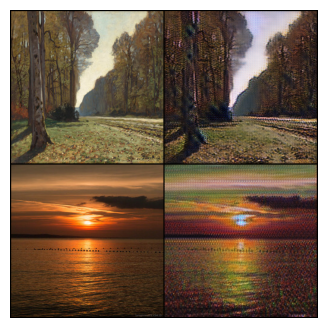

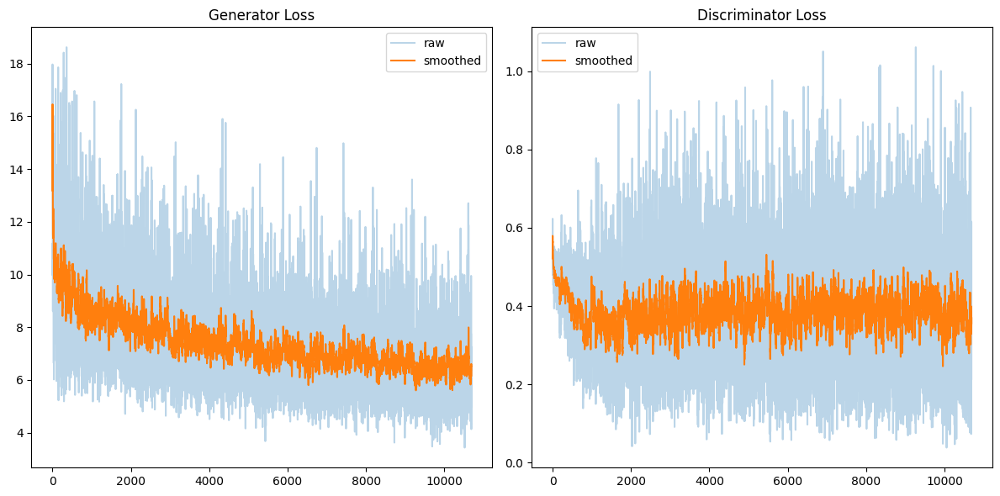

 73%|███████▎  | 4599/6287 [07:24<02:37, 10.75it/s, M_fake=0.379, M_real=0.614]

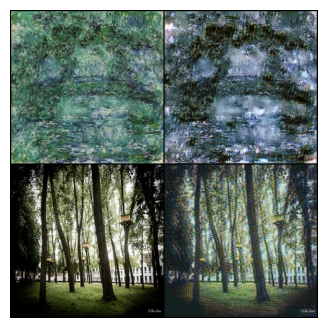

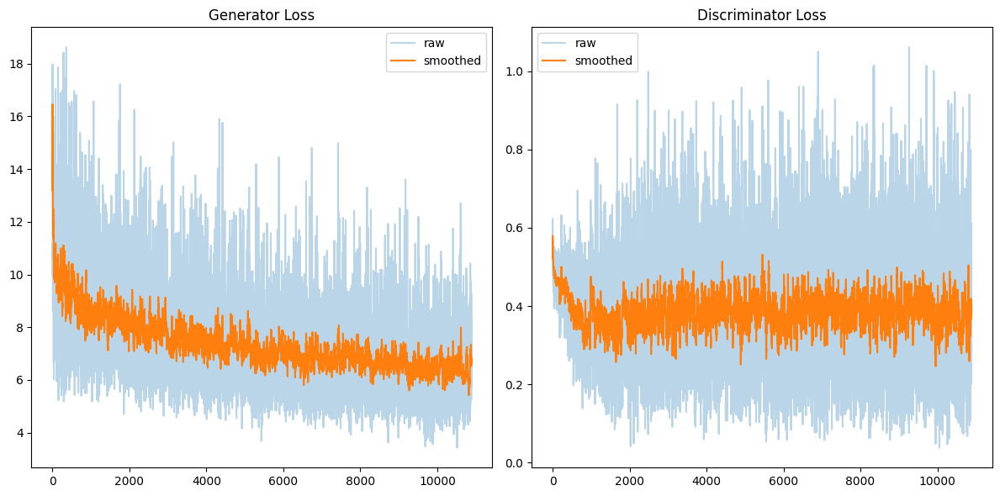

 76%|███████▋  | 4799/6287 [07:43<02:13, 11.17it/s, M_fake=0.379, M_real=0.615]

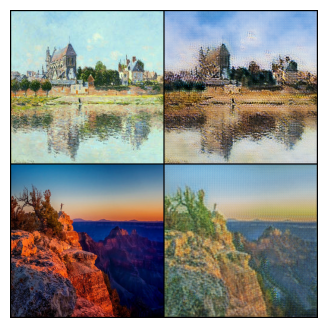

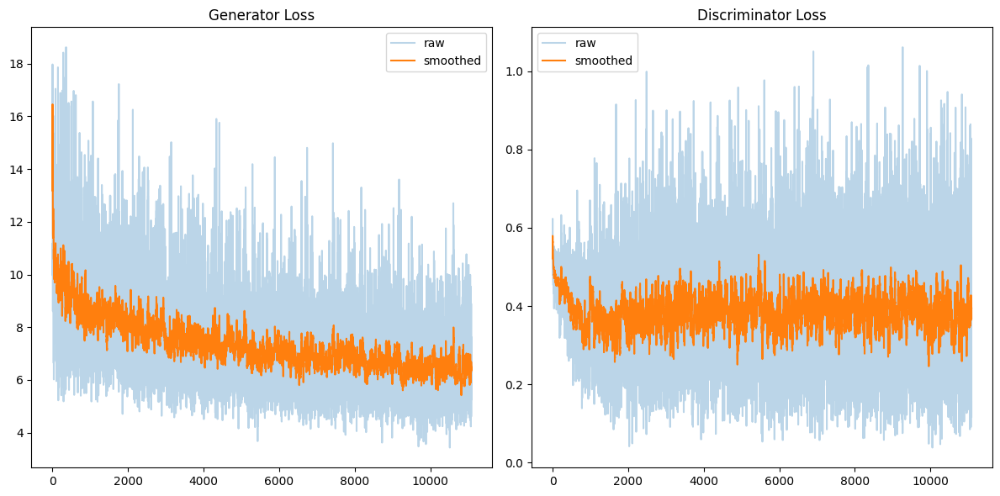

 80%|███████▉  | 4999/6287 [08:02<01:56, 11.10it/s, M_fake=0.379, M_real=0.615]

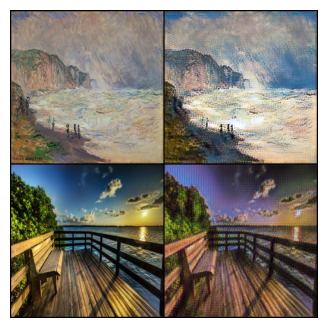

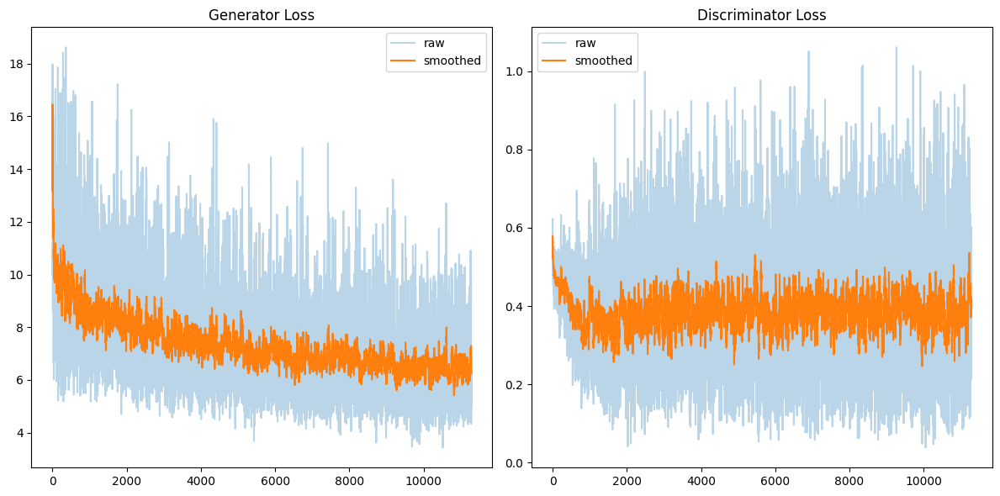

 83%|████████▎ | 5199/6287 [08:21<01:37, 11.19it/s, M_fake=0.379, M_real=0.614]

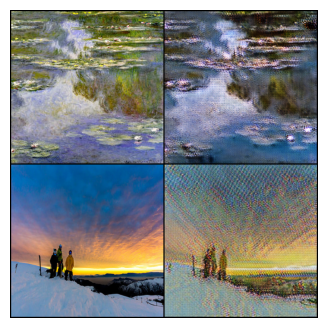

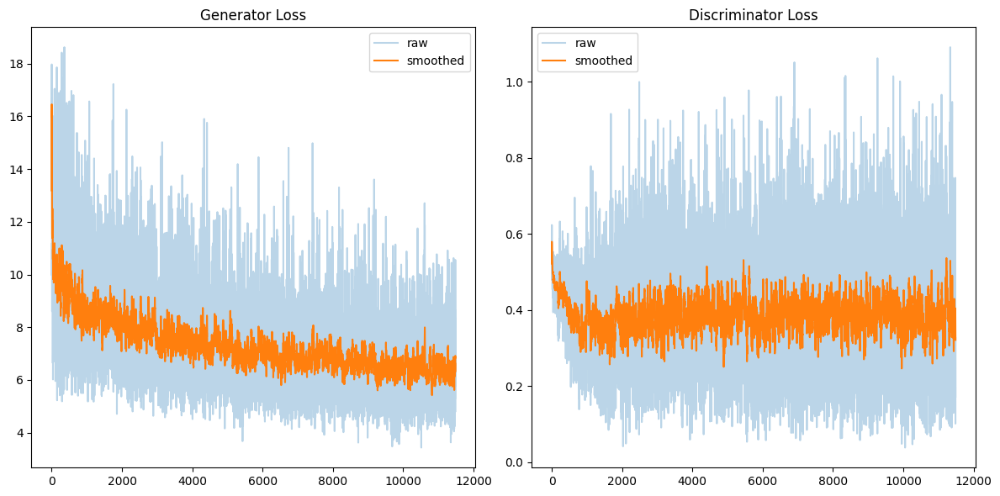

 86%|████████▌ | 5399/6287 [08:40<01:19, 11.20it/s, M_fake=0.379, M_real=0.614]

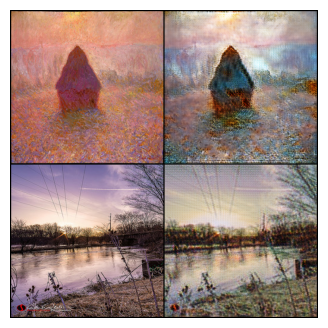

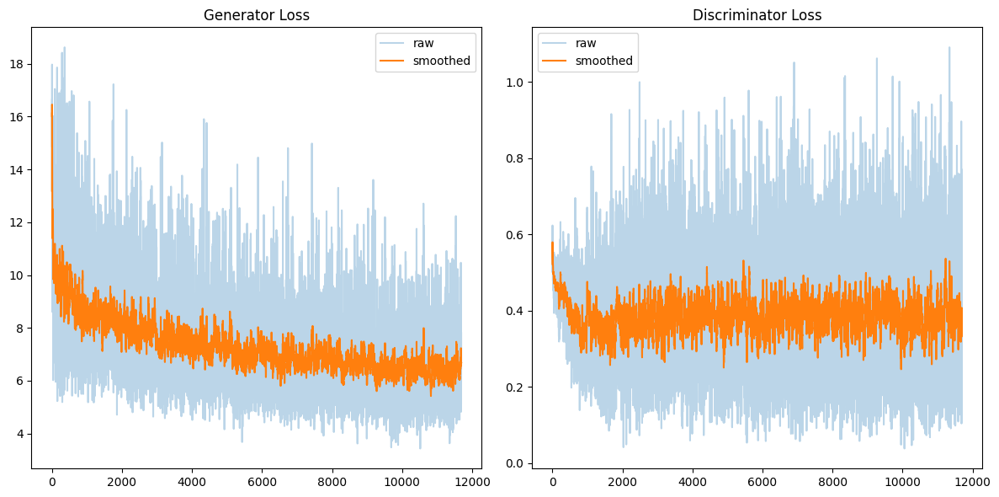

 89%|████████▉ | 5599/6287 [08:59<01:02, 11.03it/s, M_fake=0.379, M_real=0.614]

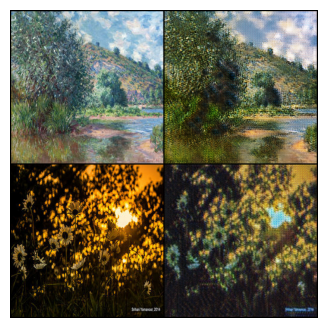

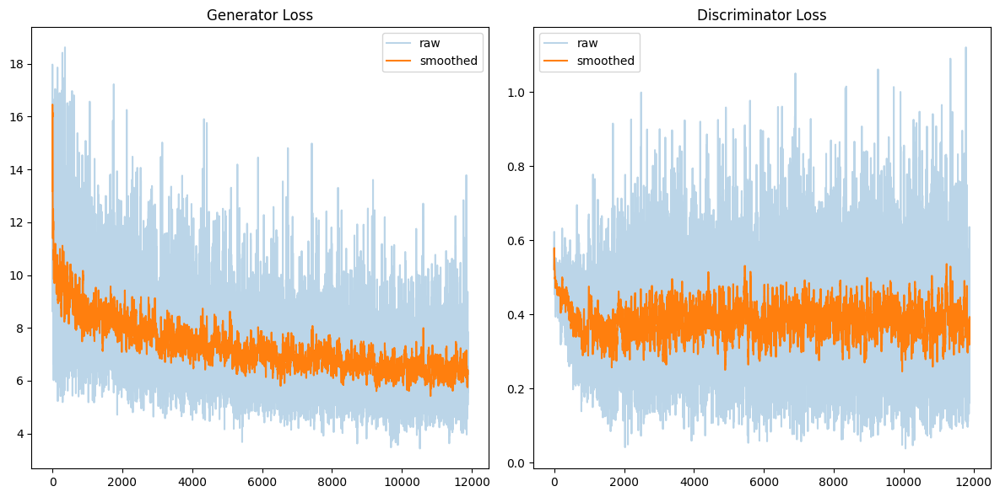

 92%|█████████▏| 5799/6287 [09:18<00:44, 11.02it/s, M_fake=0.379, M_real=0.614]

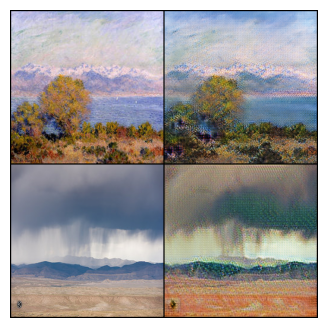

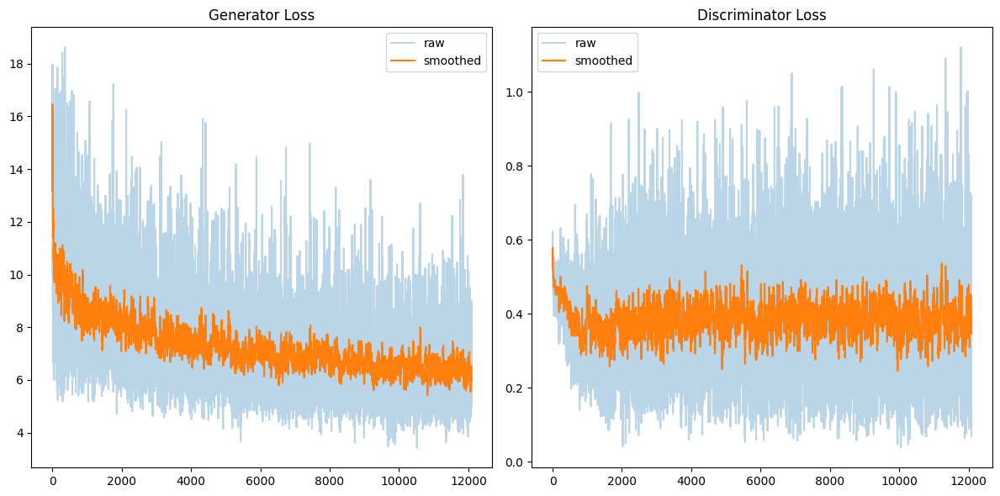

 95%|█████████▌| 5999/6287 [09:37<00:26, 10.85it/s, M_fake=0.378, M_real=0.614]

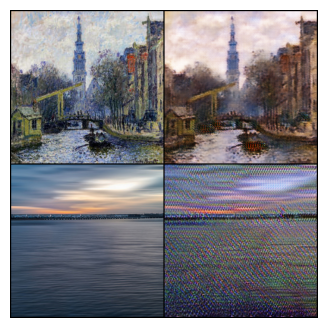

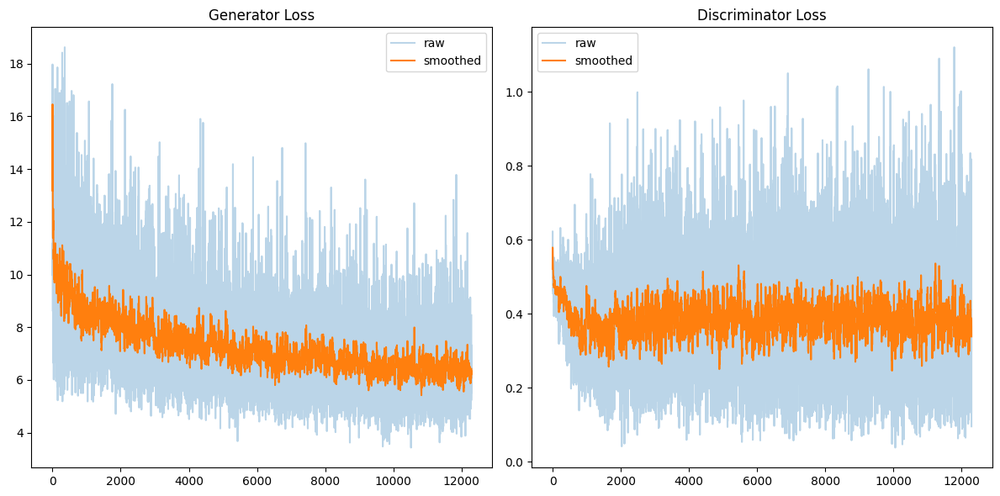

 99%|█████████▊| 6199/6287 [09:55<00:07, 11.02it/s, M_fake=0.378, M_real=0.614]

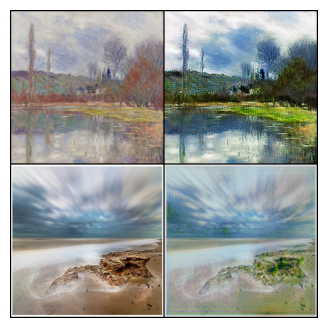

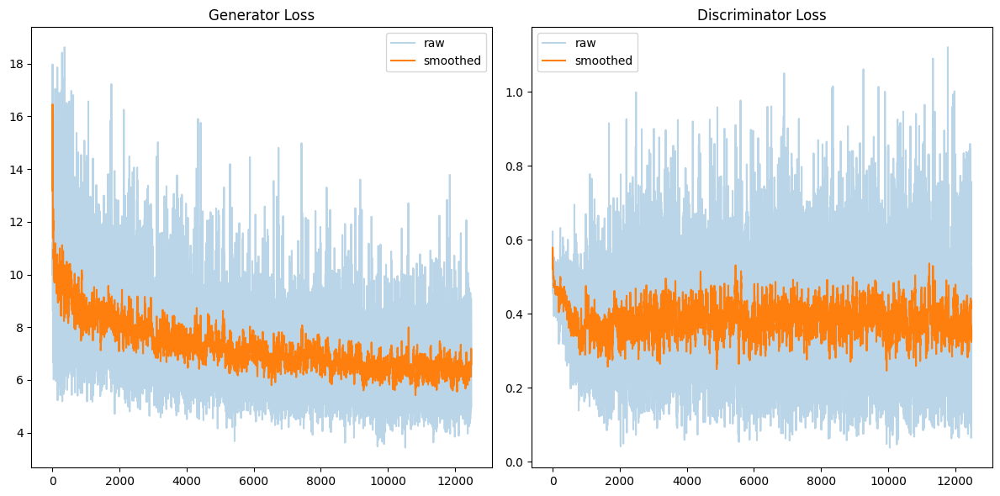

100%|██████████| 6287/6287 [10:04<00:00, 10.40it/s, M_fake=0.378, M_real=0.615]


=> Saving checkpoint
=> Saving checkpoint
=> Saving checkpoint
=> Saving checkpoint
EPOCH 2/3 finished


  0%|          | 0/6287 [00:00<?, ?it/s]

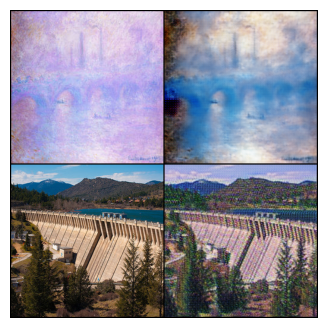

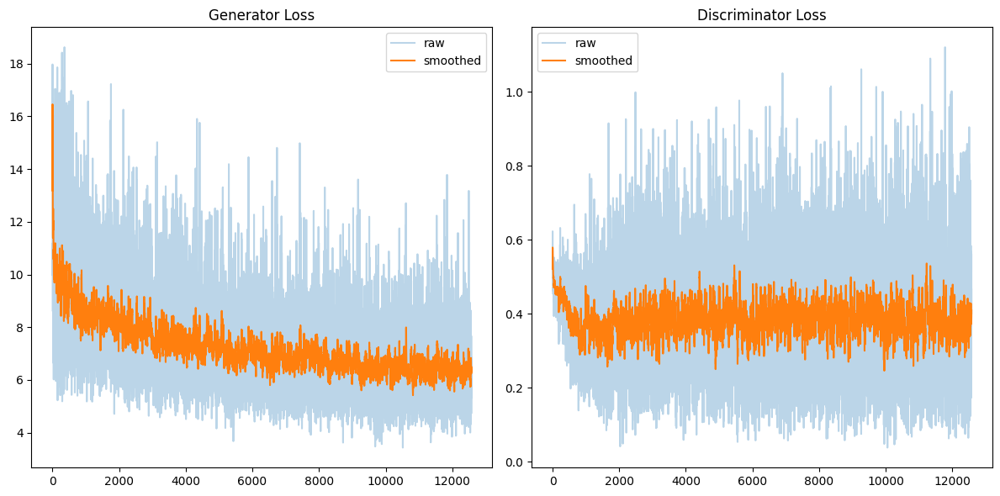

  3%|▎         | 199/6287 [00:26<09:19, 10.87it/s, M_fake=0.392, M_real=0.602]

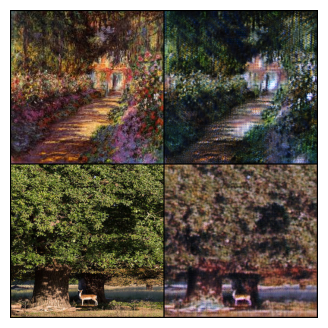

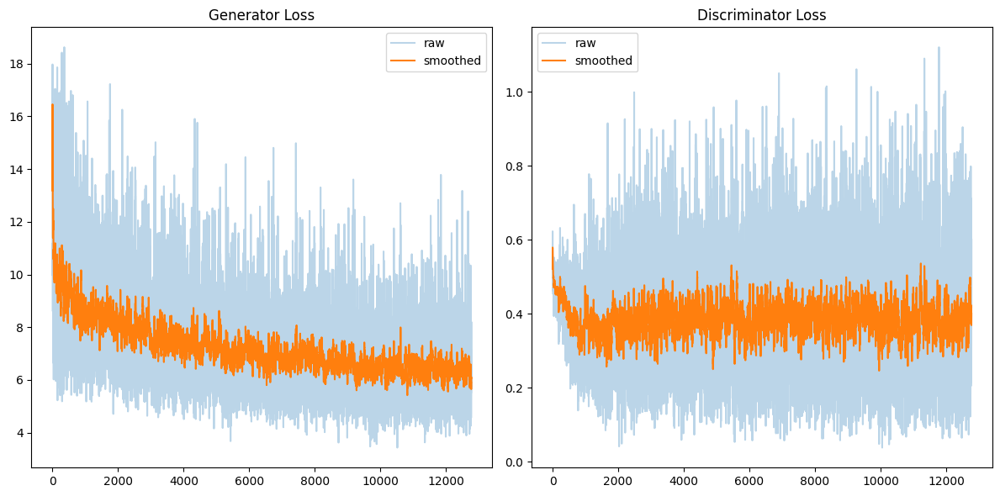

  6%|▋         | 399/6287 [00:47<08:45, 11.20it/s, M_fake=0.393, M_real=0.608]

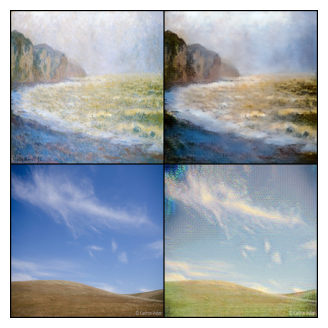

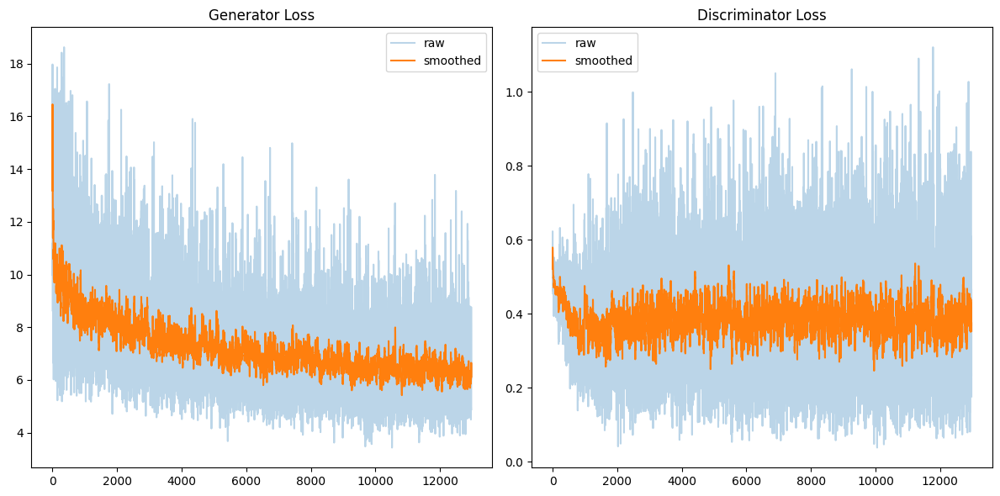

 10%|▉         | 599/6287 [01:06<08:47, 10.79it/s, M_fake=0.391, M_real=0.609]

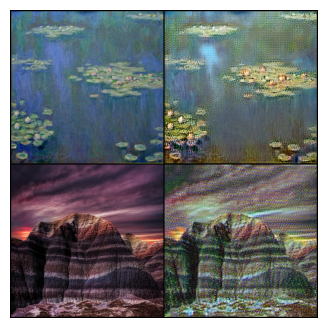

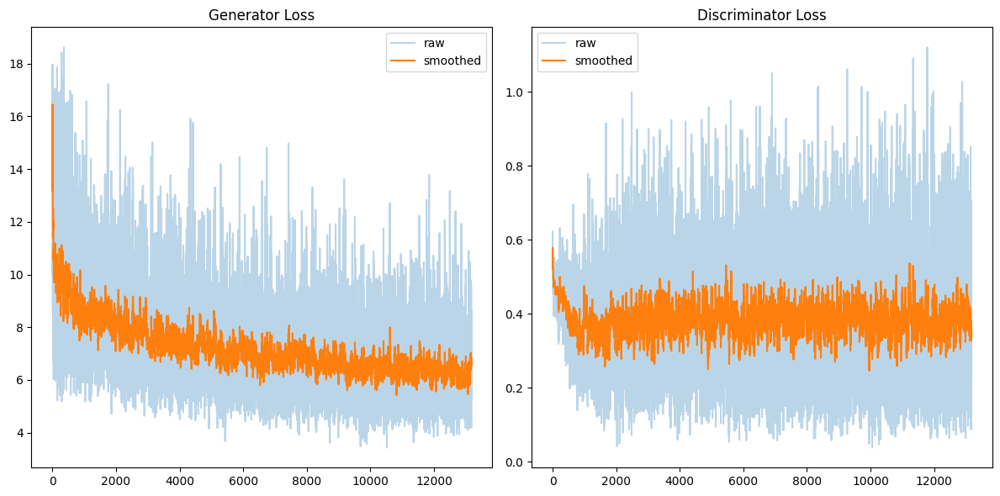

 13%|█▎        | 799/6287 [01:25<08:15, 11.08it/s, M_fake=0.385, M_real=0.616]

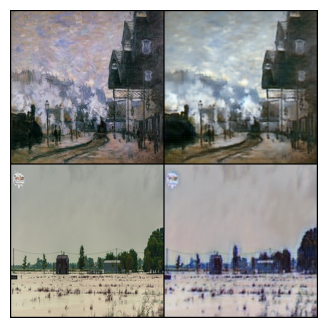

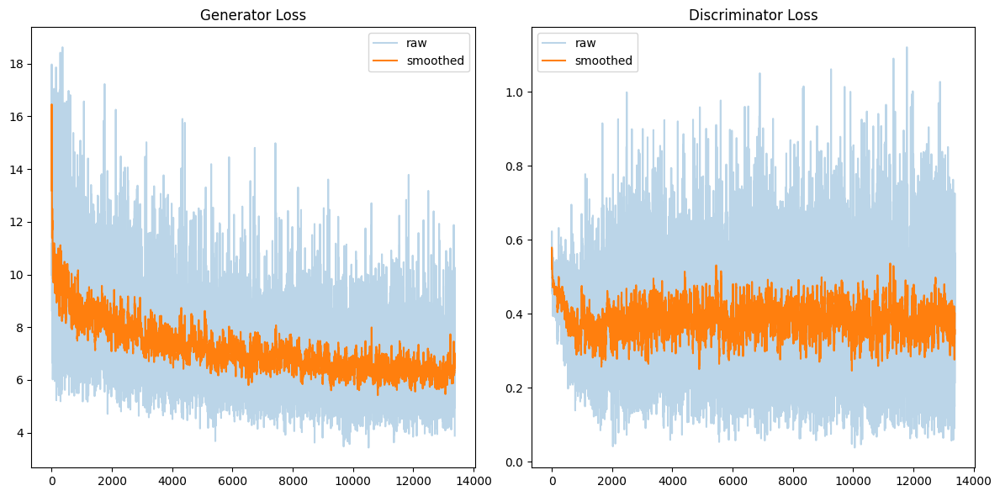

 16%|█▌        | 999/6287 [01:44<08:02, 10.96it/s, M_fake=0.384, M_real=0.616]

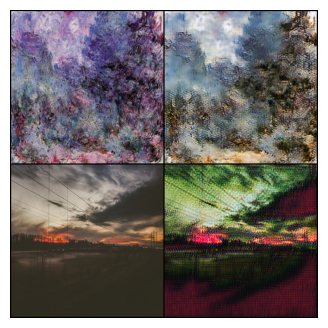

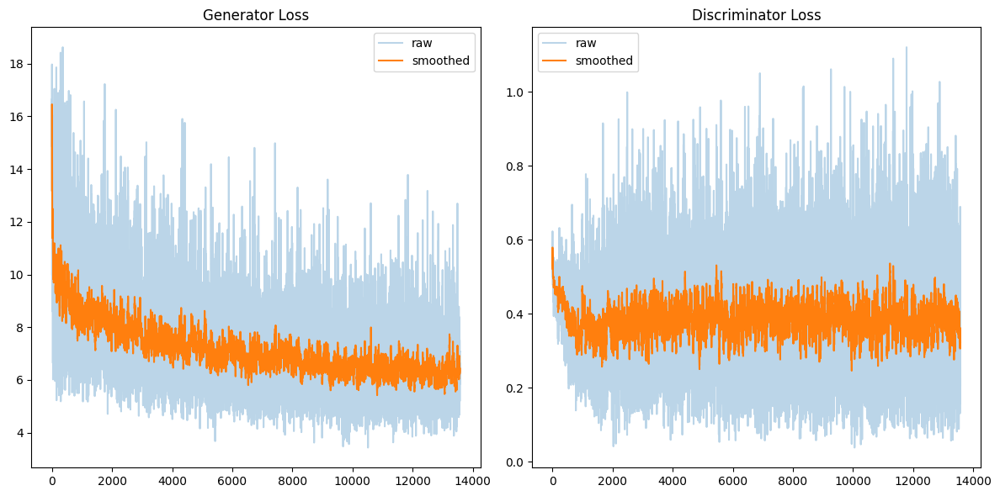

 19%|█▉        | 1199/6287 [02:03<07:48, 10.86it/s, M_fake=0.382, M_real=0.616]

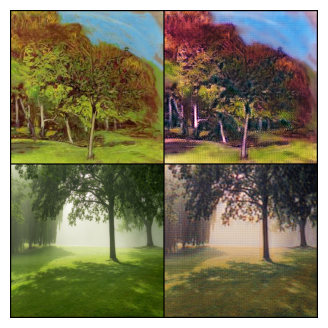

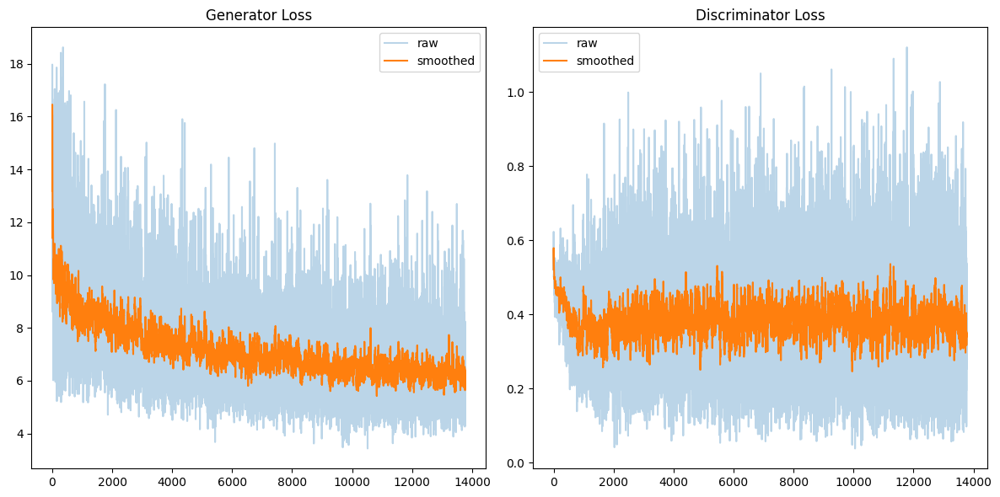

 22%|██▏       | 1399/6287 [02:22<07:22, 11.05it/s, M_fake=0.382, M_real=0.619]

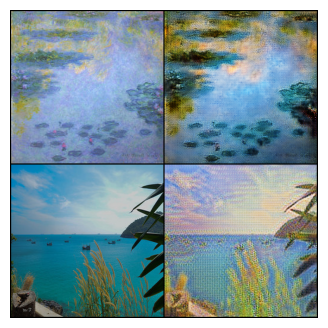

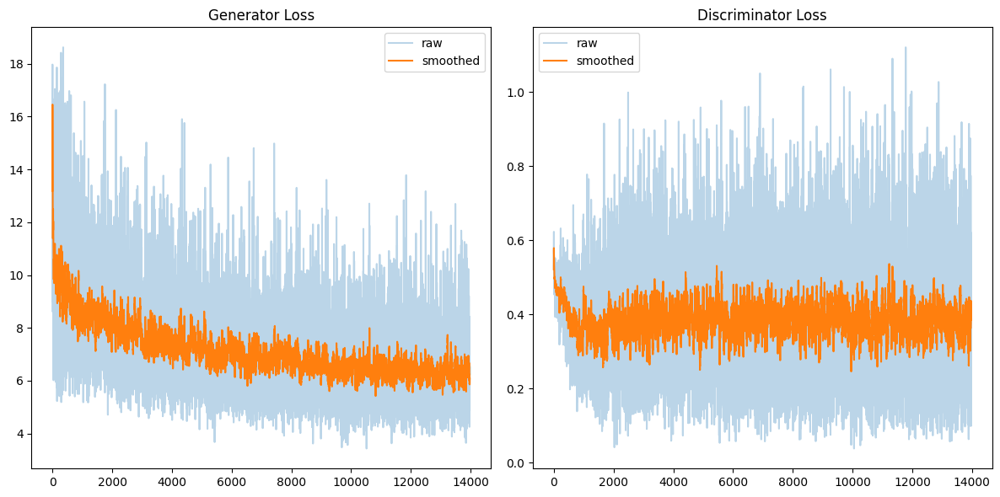

 25%|██▌       | 1599/6287 [02:41<07:00, 11.15it/s, M_fake=0.38, M_real=0.619]

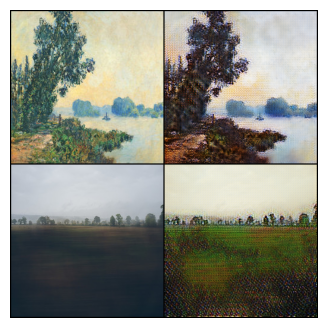

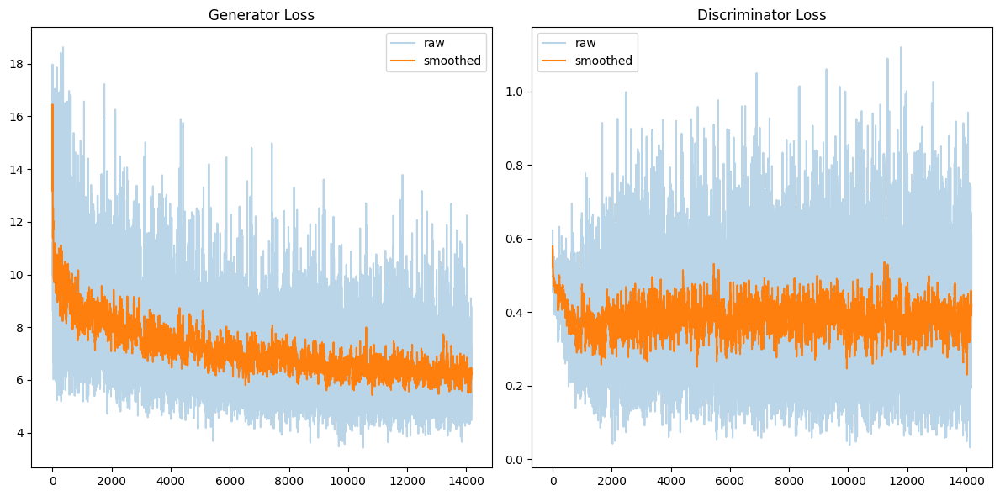

 29%|██▊       | 1800/6287 [03:00<06:48, 10.98it/s, M_fake=0.379, M_real=0.62]

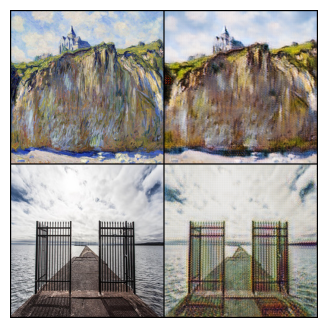

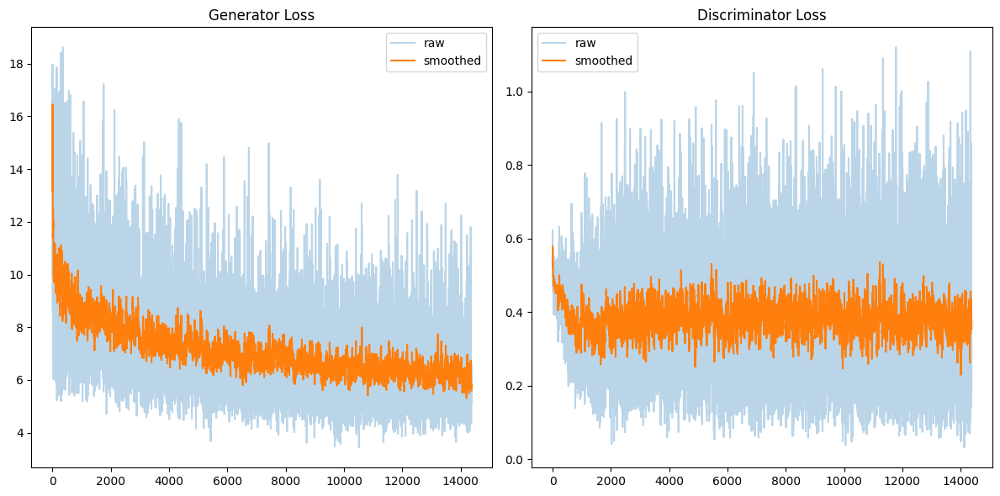

 32%|███▏      | 2000/6287 [03:19<06:39, 10.73it/s, M_fake=0.38, M_real=0.62]

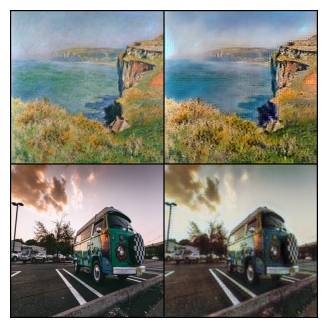

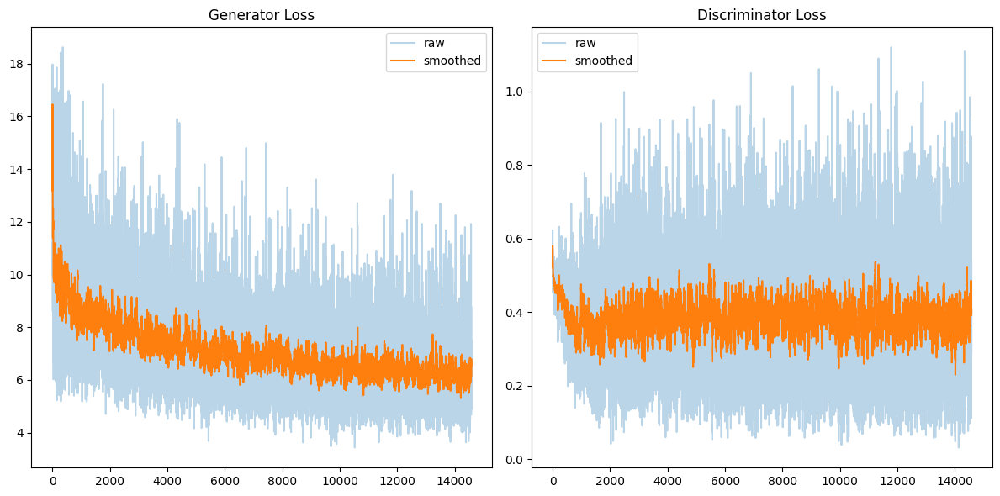

 35%|███▍      | 2200/6287 [03:38<06:07, 11.12it/s, M_fake=0.38, M_real=0.619]

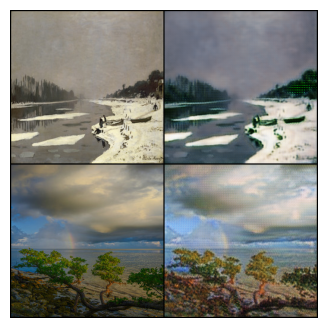

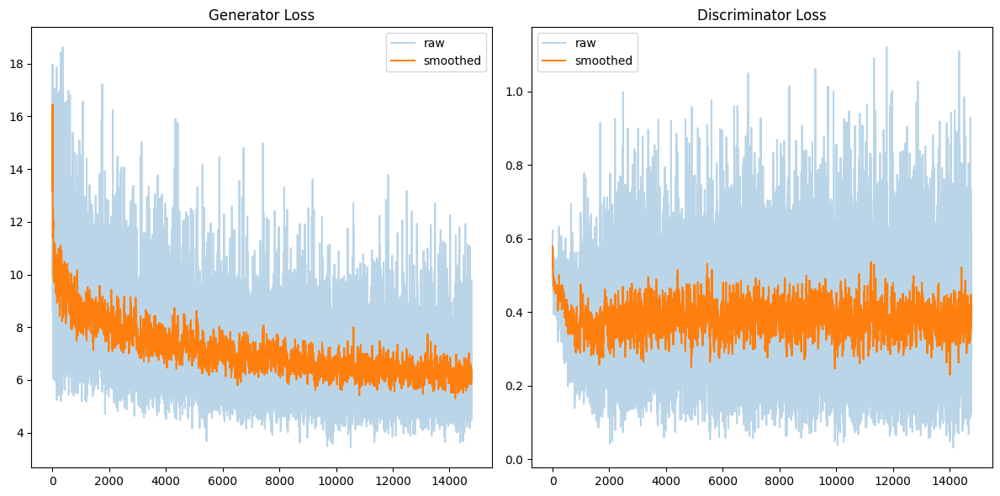

 38%|███▊      | 2400/6287 [03:57<05:53, 11.00it/s, M_fake=0.381, M_real=0.619]

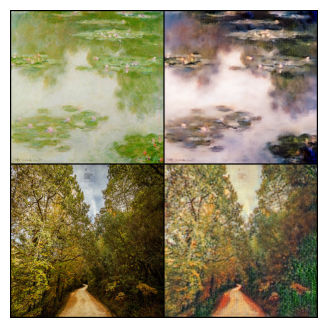

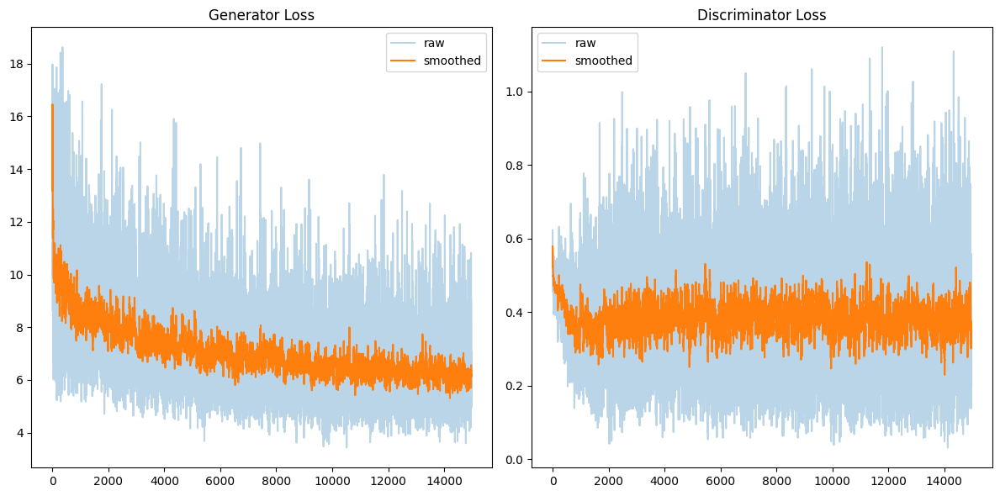

 41%|████▏     | 2600/6287 [04:16<05:38, 10.90it/s, M_fake=0.382, M_real=0.618]

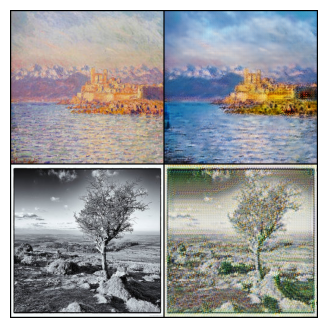

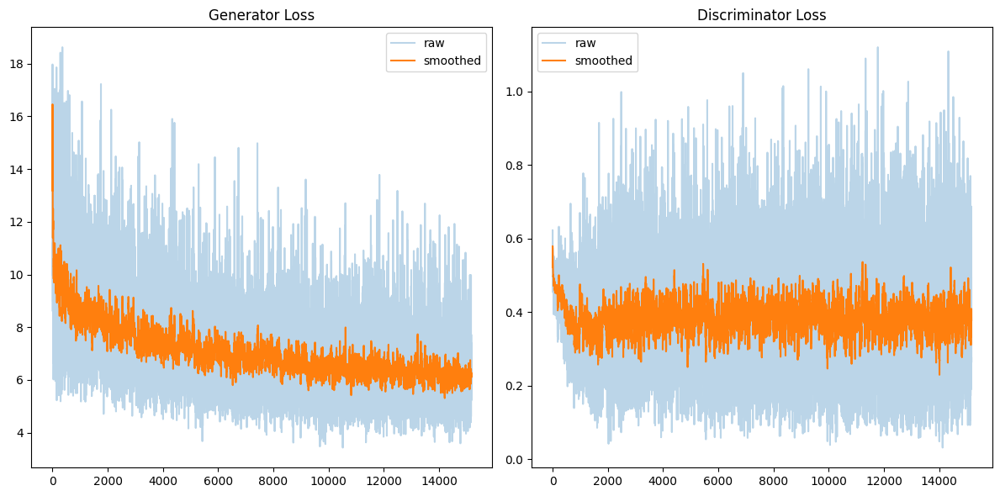

 45%|████▍     | 2800/6287 [04:35<05:11, 11.20it/s, M_fake=0.381, M_real=0.618]

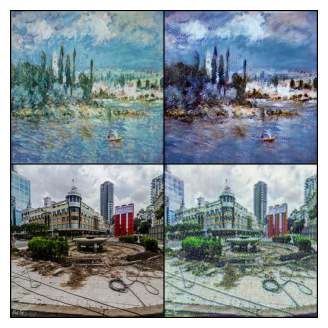

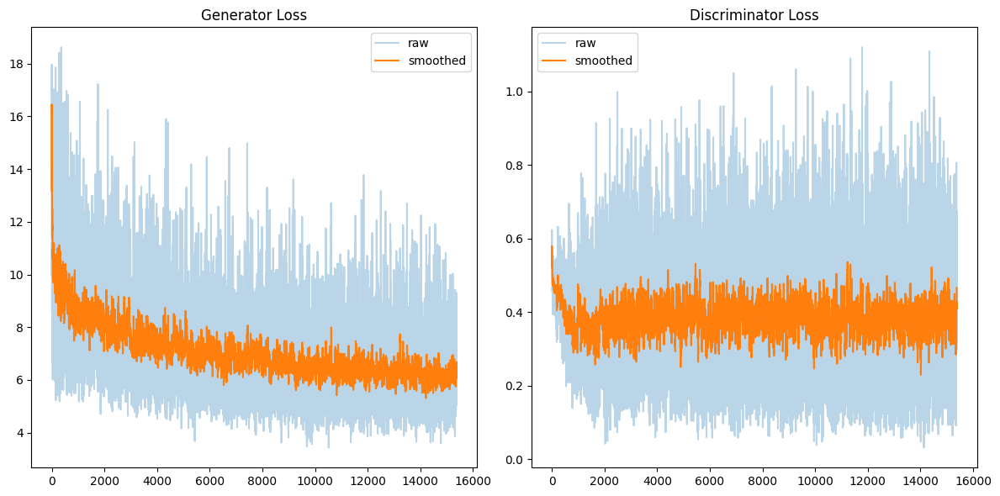

 48%|████▊     | 3000/6287 [04:54<05:01, 10.91it/s, M_fake=0.381, M_real=0.618]

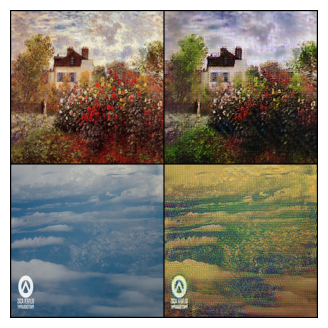

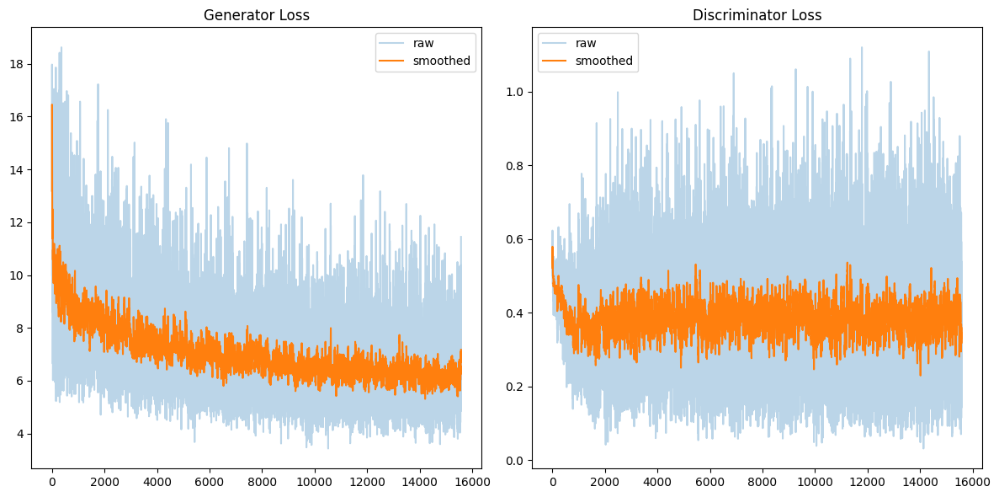

 51%|█████     | 3200/6287 [05:13<04:39, 11.04it/s, M_fake=0.38, M_real=0.617]

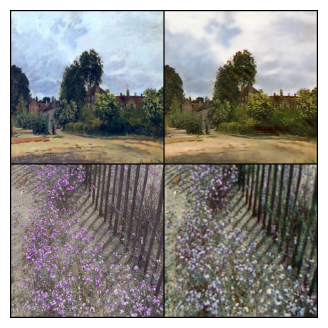

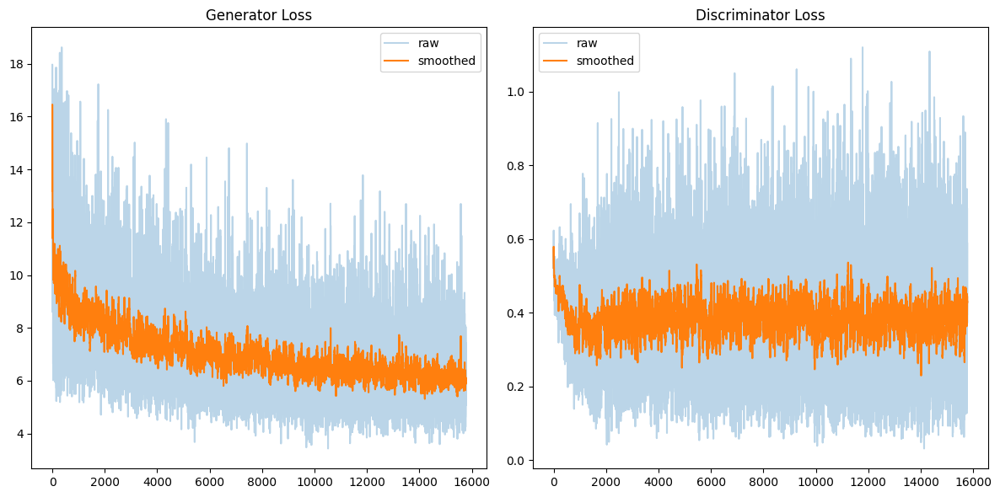

 54%|█████▍    | 3400/6287 [05:32<04:23, 10.96it/s, M_fake=0.381, M_real=0.617]

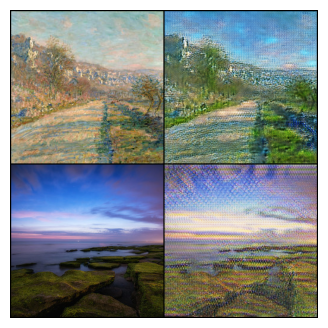

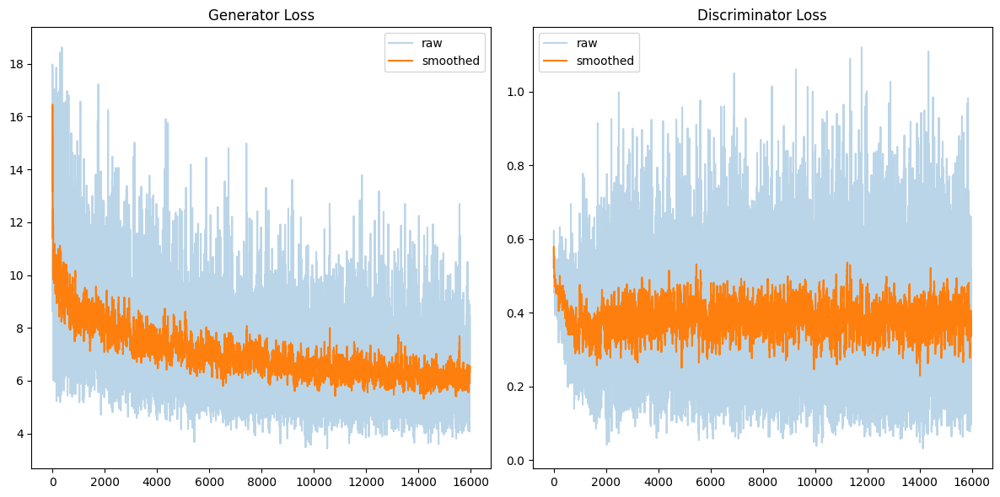

 57%|█████▋    | 3600/6287 [05:51<04:06, 10.89it/s, M_fake=0.38, M_real=0.617]

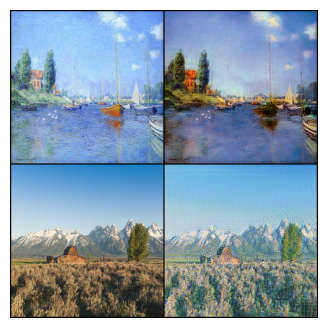

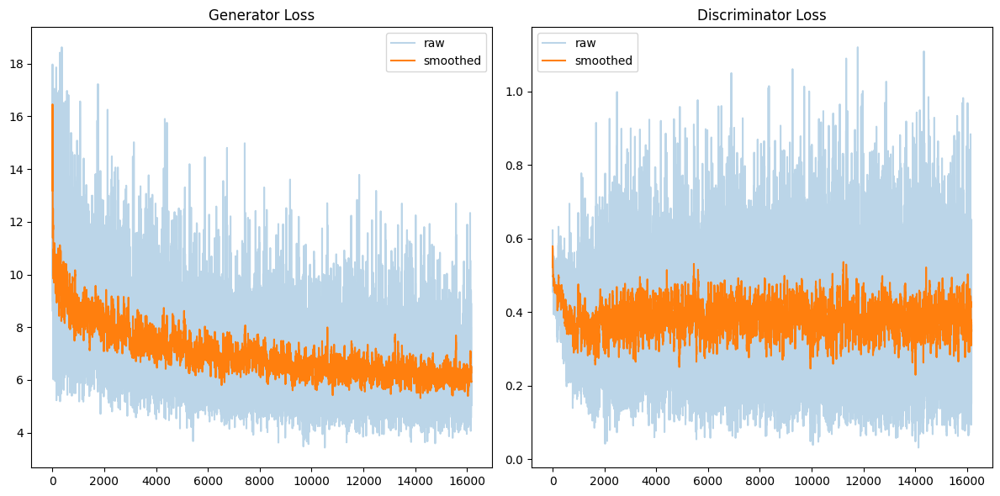

 60%|██████    | 3800/6287 [06:10<03:41, 11.22it/s, M_fake=0.38, M_real=0.617]

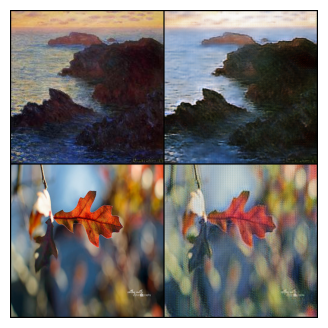

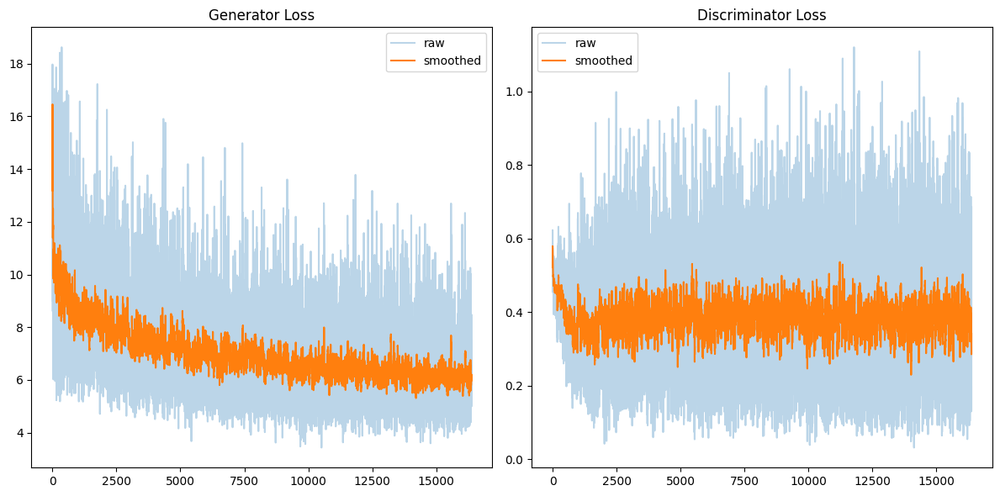

 64%|██████▎   | 4000/6287 [06:29<03:27, 11.01it/s, M_fake=0.38, M_real=0.617]

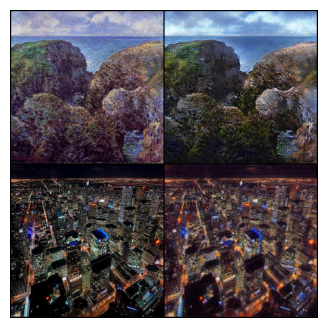

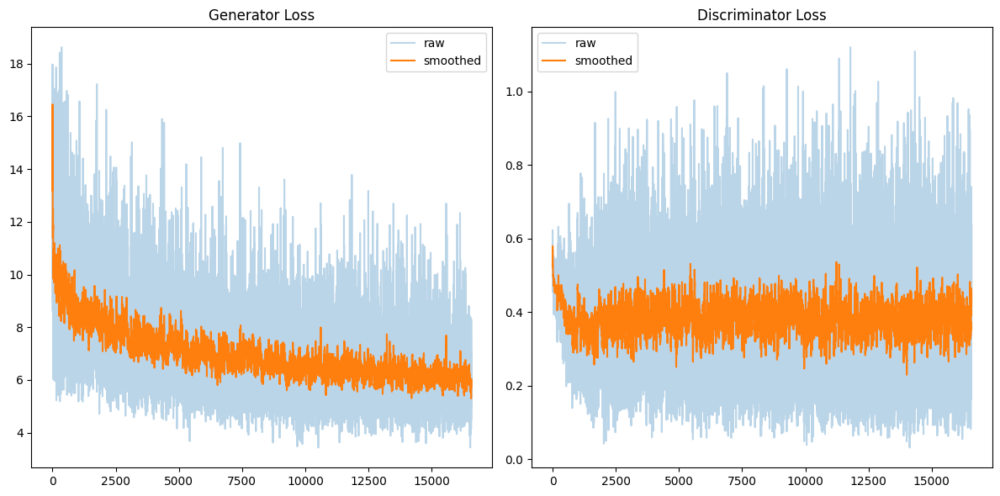

 67%|██████▋   | 4200/6287 [06:48<03:05, 11.24it/s, M_fake=0.38, M_real=0.617]

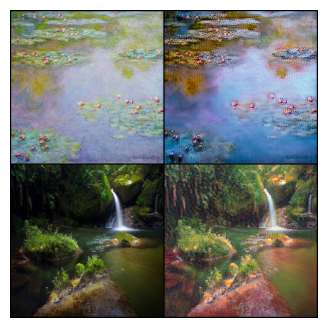

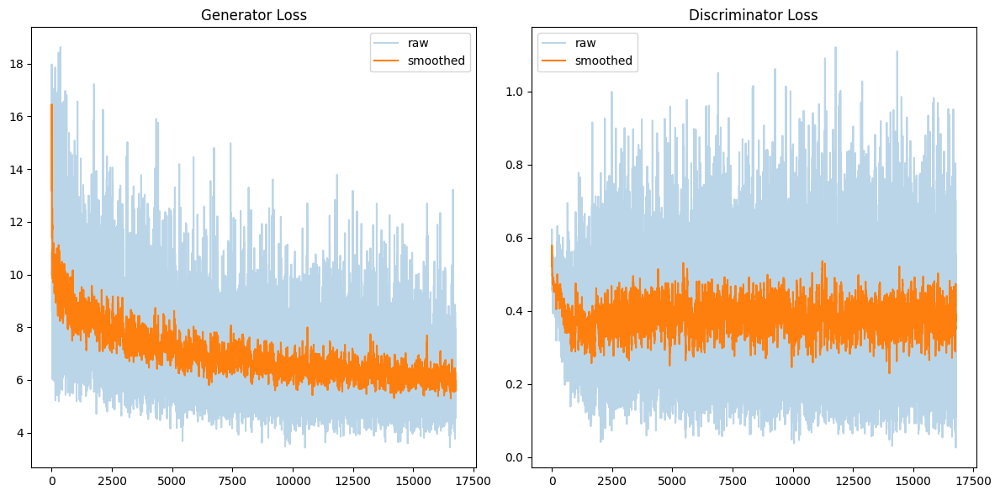

 70%|██████▉   | 4400/6287 [07:07<02:54, 10.79it/s, M_fake=0.38, M_real=0.617]

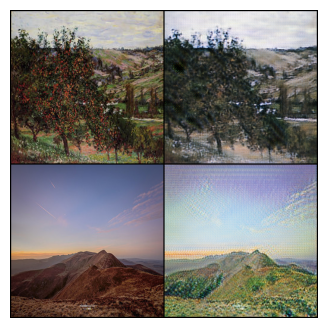

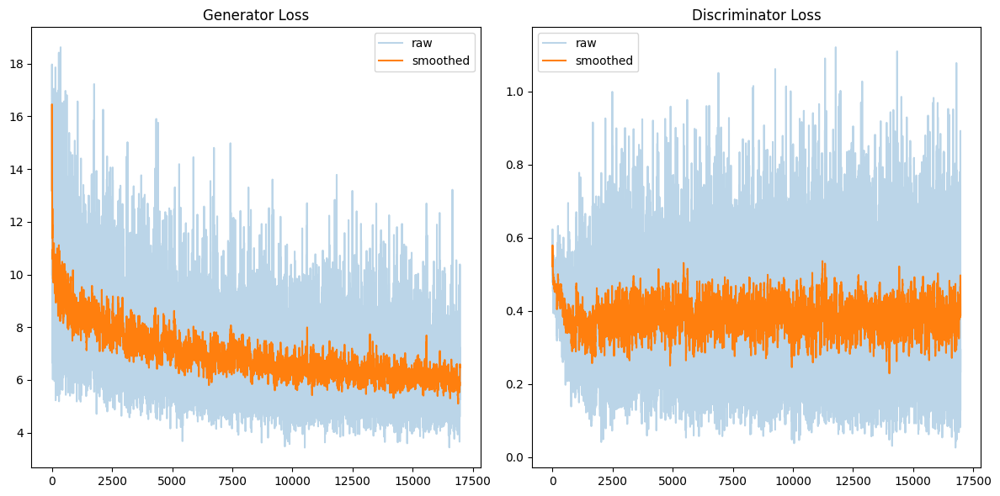

 73%|███████▎  | 4600/6287 [07:26<02:32, 11.06it/s, M_fake=0.379, M_real=0.617]

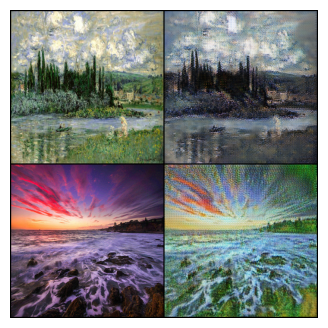

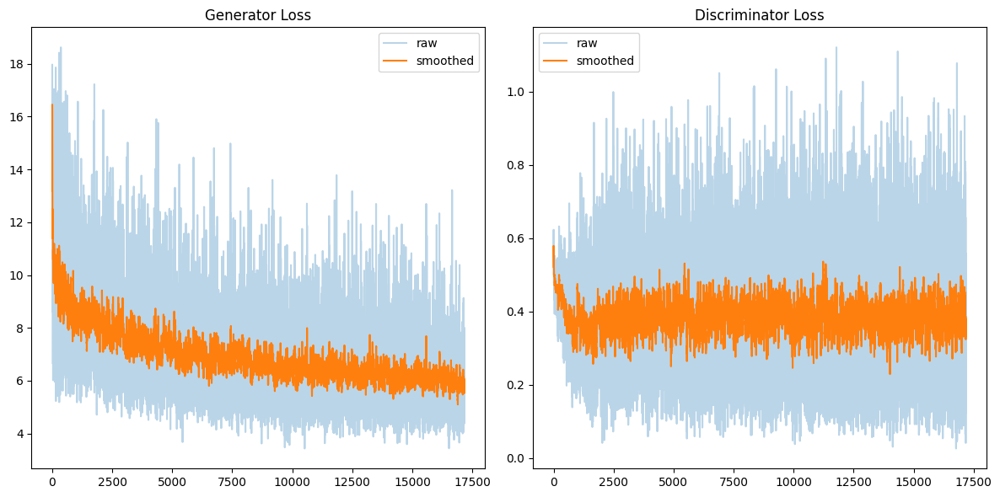

 76%|███████▋  | 4800/6287 [07:45<02:15, 10.98it/s, M_fake=0.379, M_real=0.616]

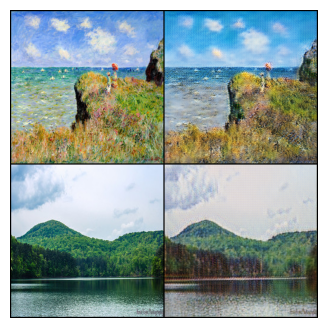

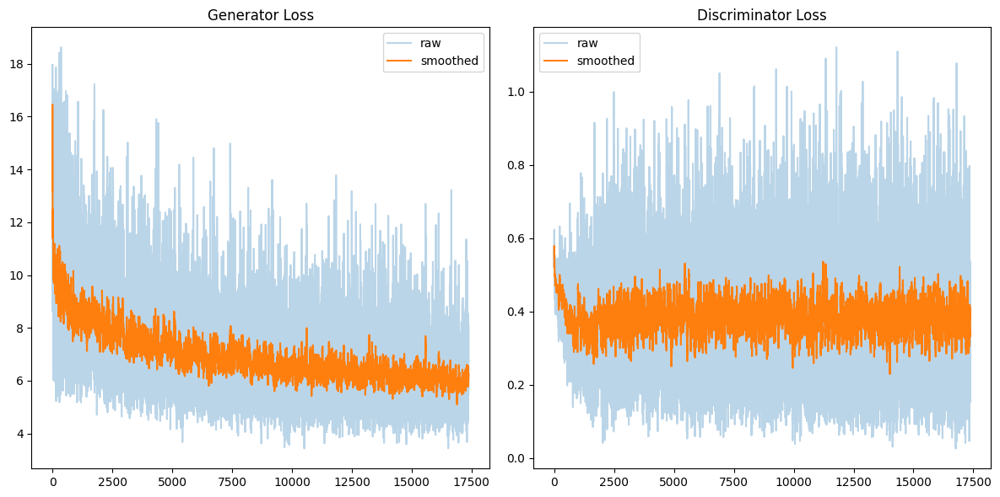

 80%|███████▉  | 5000/6287 [08:04<01:58, 10.89it/s, M_fake=0.379, M_real=0.616]

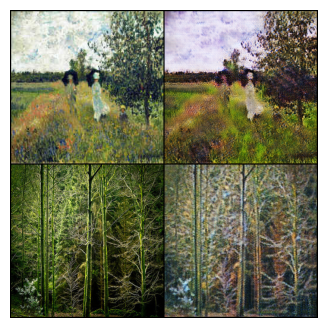

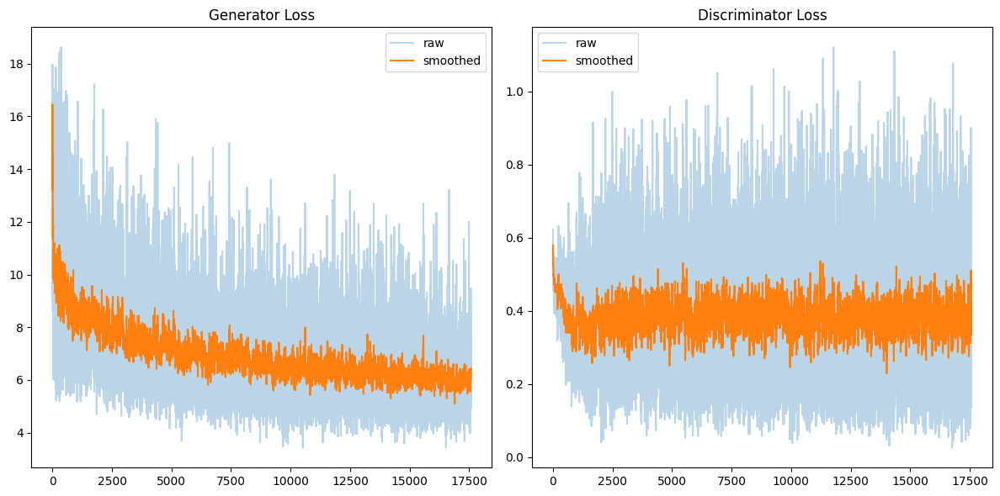

 83%|████████▎ | 5200/6287 [08:23<01:39, 10.95it/s, M_fake=0.379, M_real=0.616]

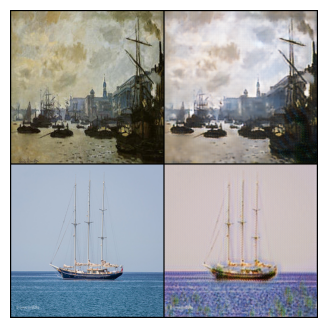

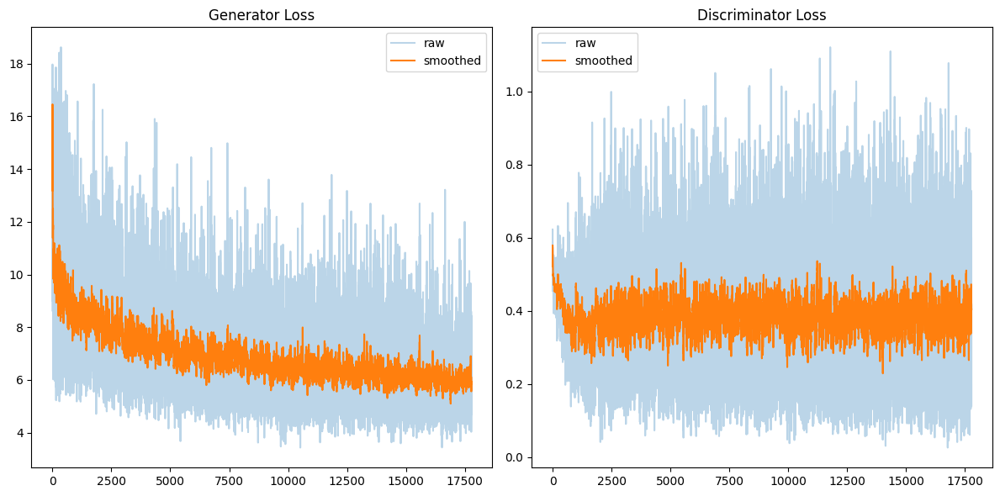

 86%|████████▌ | 5400/6287 [08:43<01:23, 10.57it/s, M_fake=0.379, M_real=0.616]

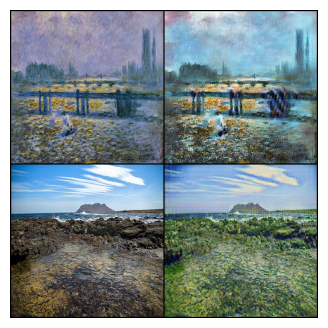

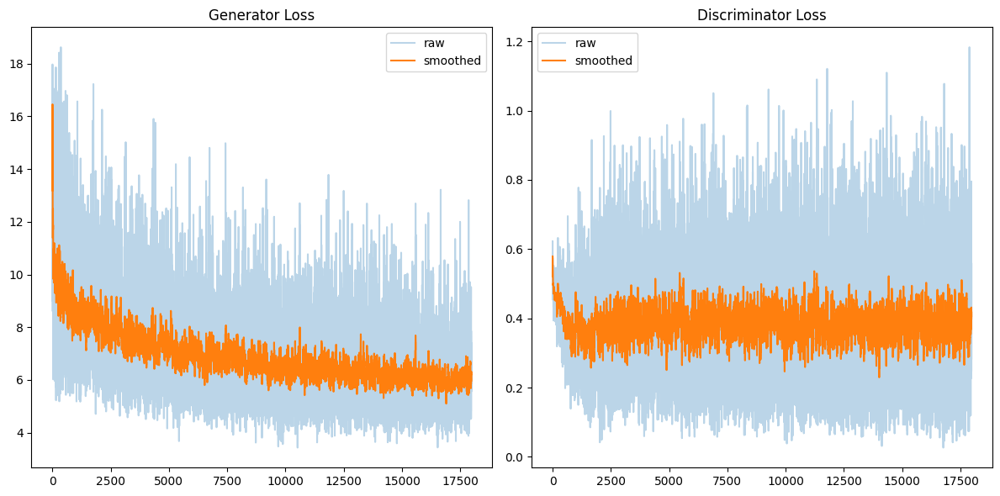

 89%|████████▉ | 5600/6287 [09:02<01:02, 10.99it/s, M_fake=0.379, M_real=0.616]

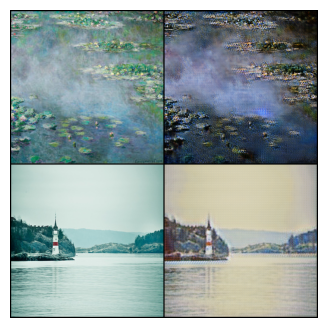

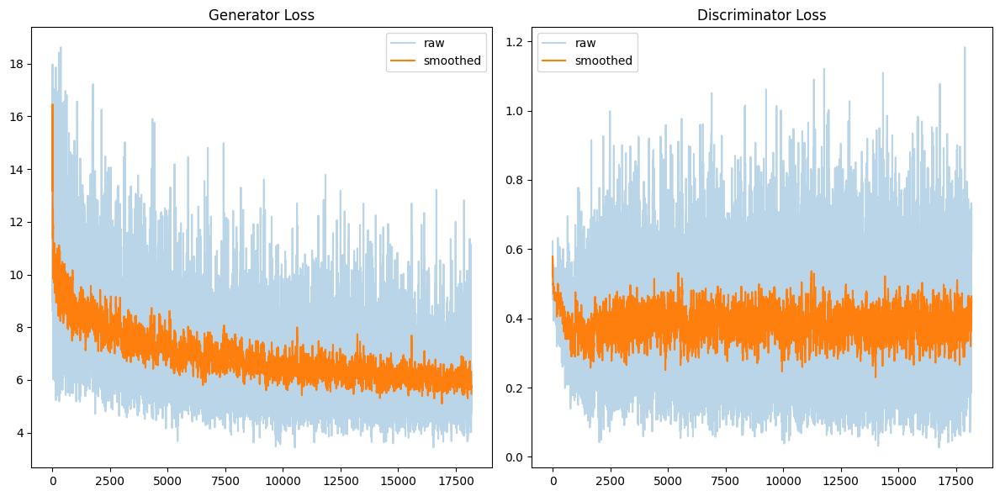

 92%|█████████▏| 5800/6287 [09:21<00:45, 10.70it/s, M_fake=0.379, M_real=0.617]

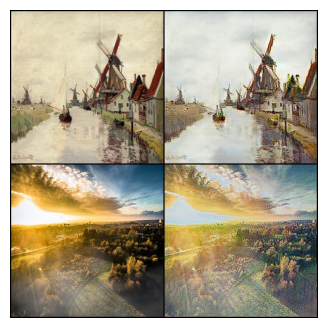

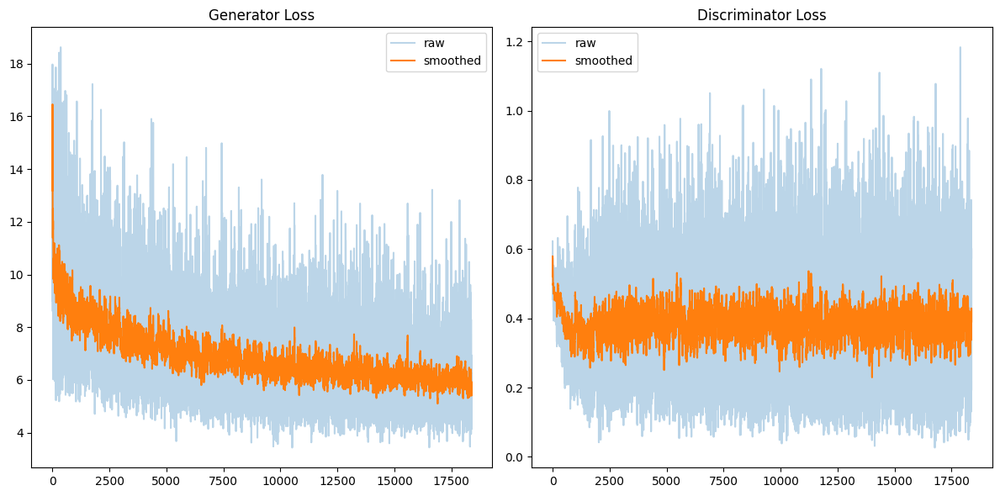

 95%|█████████▌| 6000/6287 [09:40<00:26, 10.92it/s, M_fake=0.379, M_real=0.617]

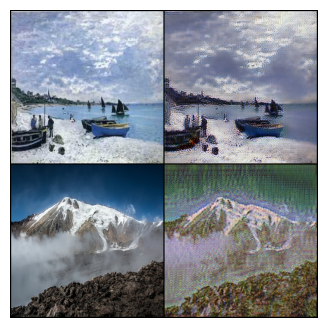

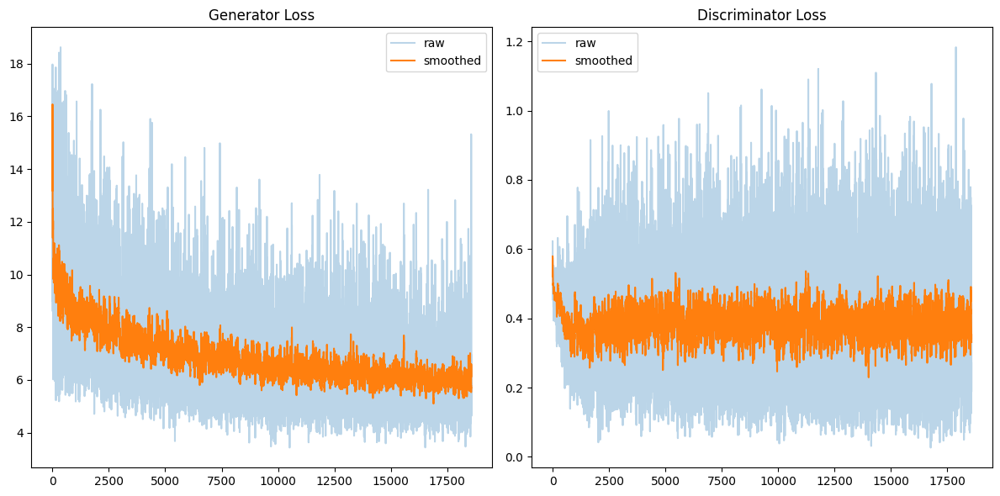

 99%|█████████▊| 6200/6287 [09:59<00:07, 11.09it/s, M_fake=0.379, M_real=0.617]

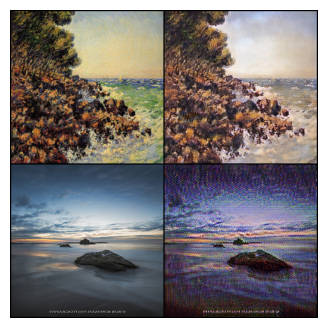

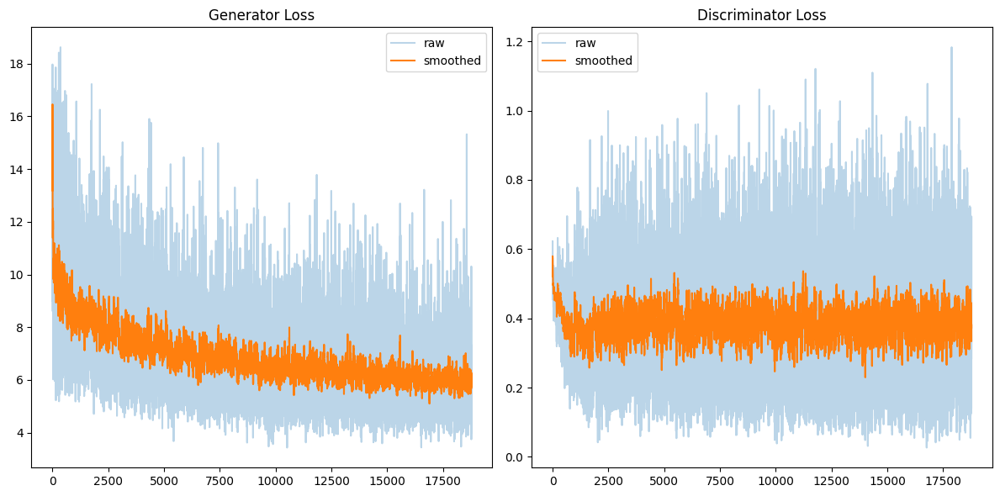

100%|██████████| 6287/6287 [10:08<00:00, 10.33it/s, M_fake=0.379, M_real=0.617]


=> Saving checkpoint
=> Saving checkpoint
=> Saving checkpoint
=> Saving checkpoint
EPOCH 3/3 finished


In [ ]:

disc_M = Discriminator().to(DEVICE)
disc_P = Discriminator().to(DEVICE)
gen_P = Generator().to(DEVICE)
gen_M = Generator().to(DEVICE)

# use Adam Optimizer for both generator and discriminator
opt_disc = optim.Adam(
    list(disc_M.parameters()) + list(disc_P.parameters()),
    lr=LEARNING_RATE,
    betas=(0.5, 0.999),
)

opt_gen = optim.Adam(
    list(gen_P.parameters()) + list(gen_M.parameters()),
    lr=LEARNING_RATE,
    betas=(0.5, 0.999),
)

L1 = nn.L1Loss()
mse = nn.MSELoss()

if LOAD_MODEL:
    load_checkpoint(
        CHECKPOINT_GENERATOR_M,
        gen_M,
        opt_gen,
        LEARNING_RATE,
    )
    load_checkpoint(
        CHECKPOINT_GENERATOR_P,
        gen_P,
        opt_gen,
        LEARNING_RATE,
    )
    load_checkpoint(
        CHECKPOINT_DISCRIMINATOR_M,
        disc_M,
        opt_disc,
        LEARNING_RATE,
    )
    load_checkpoint(
        CHECKPOINT_DISCRIMINATOR_P,
        disc_P,
        opt_disc,
        LEARNING_RATE,
    )

dataset = MonetPhotoDataset(
    root_monet="./trainA",
    root_photo="./trainB",
    transform=transforms,
)
val_dataset = MonetPhotoDataset(
    root_monet="./testA",
    root_photo="./testB",
    transform=transforms,
)
val_loader = DataLoader(
    val_dataset,
    batch_size=BATCH_SIZE,
    shuffle=False,
    pin_memory=True,
)
loader = DataLoader(
    dataset,
    batch_size=BATCH_SIZE,
    shuffle=True,
    num_workers=NUM_WORKERS,
    pin_memory=True,
)
g_scaler = torch.cuda.amp.GradScaler()
d_scaler = torch.cuda.amp.GradScaler()
g_scheduler = optim.lr_scheduler.LambdaLR(opt_gen, lr_lambda=my_scheduler)
d_scheduler = optim.lr_scheduler.LambdaLR(opt_disc, lr_lambda=my_scheduler)
g_losses = []
d_losses = []

for epoch in range(NUM_EPOCHS):


    train_fn(
        disc_M,
        disc_P,
        gen_P,
        gen_M,
        loader,
        opt_disc,
        opt_gen,
        L1,
        mse,
        d_scaler,
        g_scaler,
        g_losses,
        d_losses
    )
    g_scheduler.step()
    d_scheduler.step()

    if SAVE_MODEL:
        save_checkpoint(gen_M, opt_gen, filename=CHECKPOINT_GENERATOR_M)
        save_checkpoint(gen_P, opt_gen, filename=CHECKPOINT_GENERATOR_P)
        save_checkpoint(disc_M, opt_disc, filename=CHECKPOINT_DISCRIMINATOR_M)
        save_checkpoint(disc_P, opt_disc, filename=CHECKPOINT_DISCRIMINATOR_P)
    print(f"EPOCH {epoch+1}/{NUM_EPOCHS} finished")



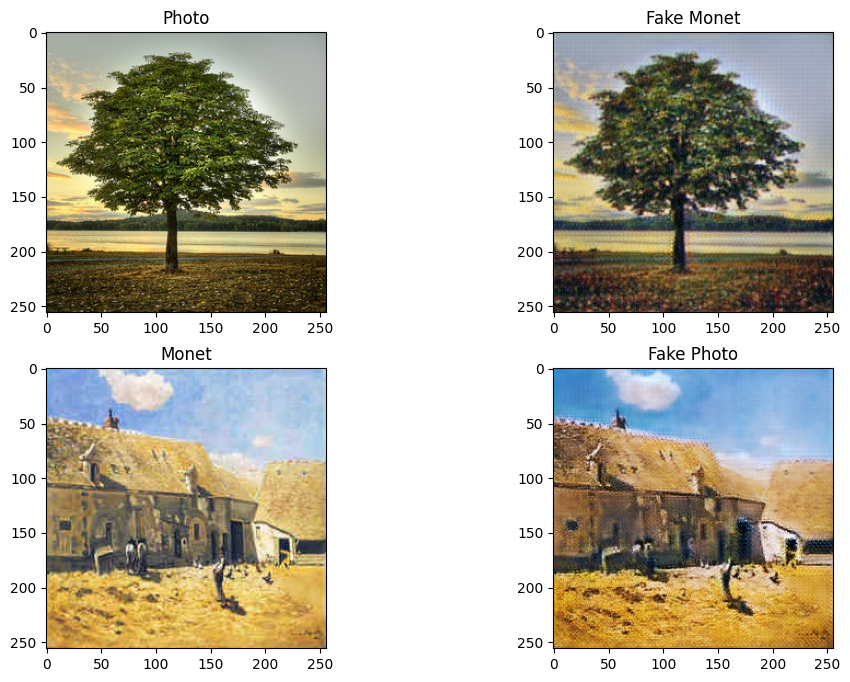

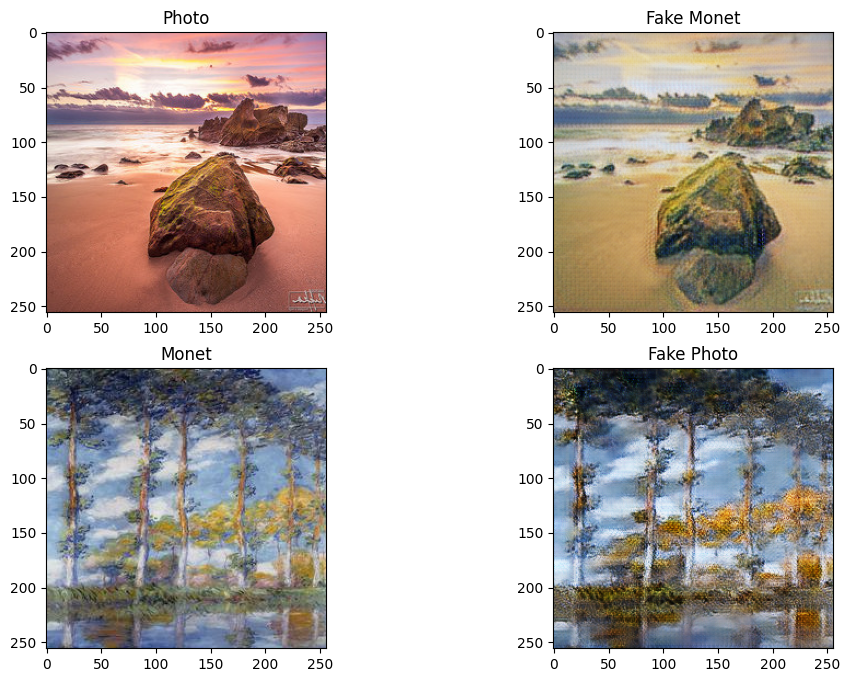

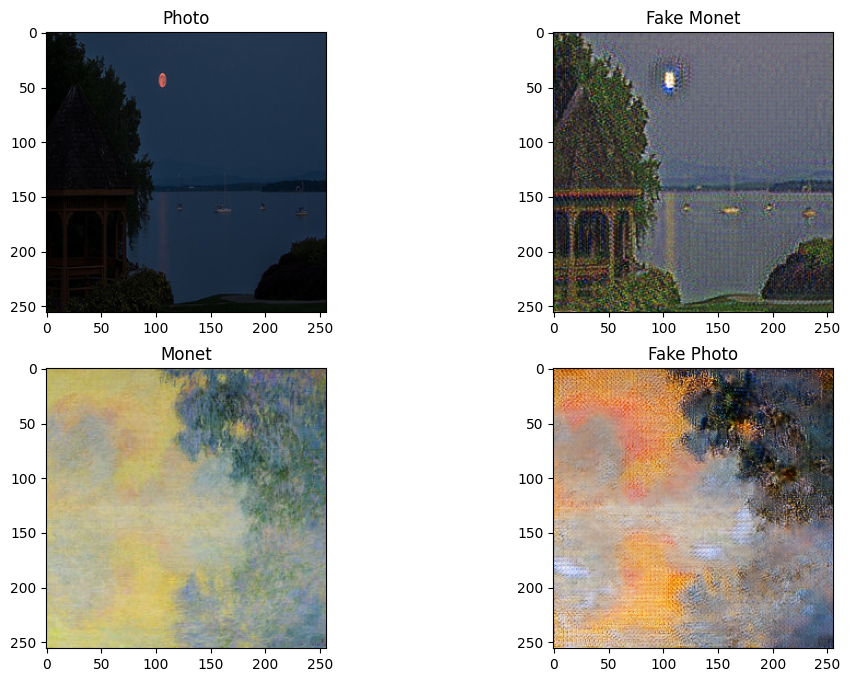

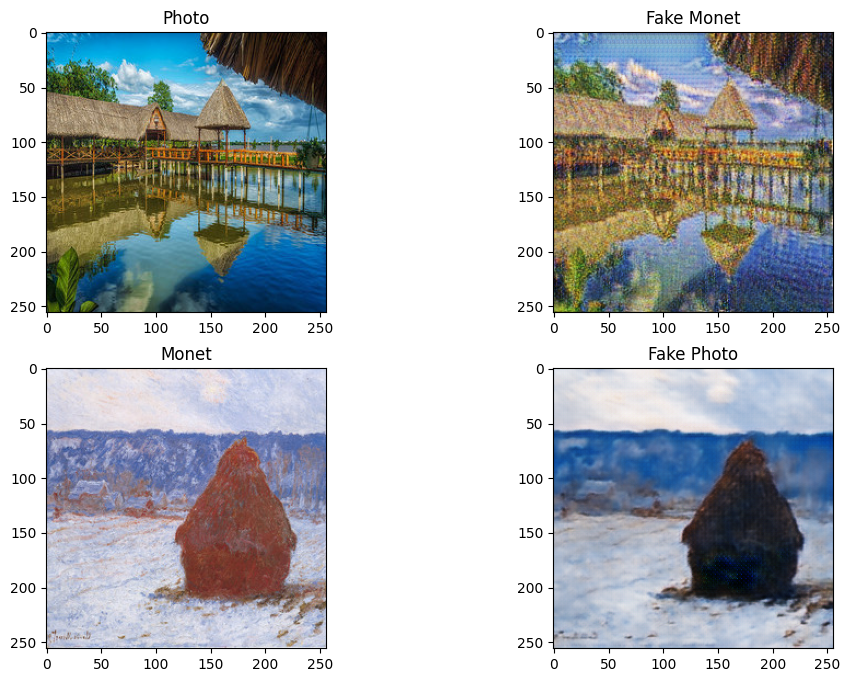

In [ ]:
val_loader = DataLoader(
    val_dataset,
    batch_size=BATCH_SIZE,
    shuffle=True,
    pin_memory=True,
)
test = iter(val_loader)
for _  in range(4):
  photo, monet = next(test)
  plt.figure(figsize=(12,8))
  photo = photo.to(DEVICE)
  monet = monet.to(DEVICE)
  fake_monet = gen_M(photo)
  fake_photo = gen_P(monet)

  plt.subplot(2, 2, 1)
  plt.imshow(denorm(photo[0].detach().cpu().permute(1, 2, 0)))
  plt.title('Photo')

  plt.subplot(2, 2, 3)
  plt.imshow(denorm(monet[0].detach().cpu().permute(1, 2, 0)))
  plt.title('Monet')

  plt.subplot(2, 2, 4)
  plt.imshow(denorm(fake_photo[0].detach().cpu().permute(1, 2, 0)))
  plt.title('Fake Photo')

  plt.subplot(2, 2, 2)
  plt.imshow(denorm(fake_monet[0].detach().cpu().permute(1, 2, 0)))
  plt.title('Fake Monet')
  plt.show()


In [ ]:
!ls